<a href="https://colab.research.google.com/github/tolgaboroglu/Data_Analysis_Miuul/blob/main/Feature_Engineering.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt

In [2]:
import missingno as msno
from datetime import date
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.neighbors import LocalOutlierFactor
from sklearn.preprocessing import MinMaxScaler, LabelEncoder, StandardScaler, RobustScaler

In [3]:
pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)
pd.set_option('display.float_format',lambda x: '%.3f'%x)
pd.set_option('display.width',500)

In [6]:
def load_application_train():
    data = pd.read_csv('/application_train.csv')
    return data   

In [7]:
df = load_application_train()
df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.000,406597.500,24700.500,351000.000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.019,-9461,-637,-3648.000,-2120.000,NaN,1.000,1.000,0.000,1.000,1.000,0.000,Laborers,1.000,2.000,2.000,WEDNESDAY,10.000,0.000,0.000,0.000,0.000,0.000,0.000,Business Entity Type 3,0.083,0.263,0.139,0.025,0.037,0.972,0.619,0.014,0.000,0.069,0.083,0.125,0.037,0.020,0.019,0.000,0.000,0.025,0.038,0.972,0.634,0.014,0.000,0.069,0.083,0.125,0.038,0.022,0.020,0.000,0.000,0.025,0.037,0.972,0.624,0.014,0.000,0.069,0.083,0.125,0.037,0.021,0.019,0.000,0.000,reg oper account,block of flats,0.015,"Stone, brick",No,2.000,2.000,2.000,2.000,-1134.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000
1,100003,0,Cash loans,F,N,N,0,270000.000,1293502.500,35698.500,1129500.000,Family,State servant,Higher education,Married,House / apartment,0.004,-16765,-1188,-1186.000,-291.000,NaN,1.000,1.000,0.000,1.000,1.000,0.000,Core staff,2.000,1.000,1.000,MONDAY,11.000,0.000,0.000,0.000,0.000,0.000,0.000,School,0.311,0.622,NaN,0.096,0.053,0.985,0.796,0.060,0.080,0.035,0.292,0.333,0.013,0.077,0.055,0.004,0.010,0.092,0.054,0.985,0.804,0.050,0.081,0.035,0.292,0.333,0.013,0.079,0.055,0.000,0.000,0.097,0.053,0.985,0.799,0.061,0.080,0.035,0.292,0.333,0.013,0.079,0.056,0.004,0.010,reg oper account,block of flats,0.071,Block,No,1.000,0.000,1.000,0.000,-828.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
2,100004,0,Revolving loans,M,Y,Y,0,67500.000,135000.000,6750.000,135000.000,Unaccompanied,Working,Secondary / secondary special,Sin

In [8]:
def load():
    data = pd.read_csv('/titanic.csv')
    return data  

In [9]:
df = load() 
df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S


##1.Outliers (Aykırı Değerler) 
 Aykırı Değerleri Yakalama
* Grafik Teknikle Aykırı Değerler
* boxplot yanında sayısal değişken için "hist" grafiği de kullanılır.

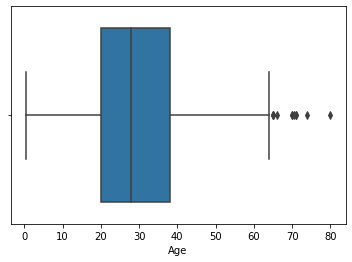

In [10]:
sns.boxplot(x=df["Age"])
plt.show(block=True)

Aykırı Değerler Nasıl Yakalanır
* Q1 hesaplanır
* Q3 hesaplanır
* bir aralık belirlenir
* IQR = Q3 - Q1



In [11]:
# Q1 
q1 = df["Age"].quantile(0.25) 
q1

20.125

In [12]:
# Q3 
q3 = df["Age"].quantile(0.75)
q3

38.0

In [13]:
# IQR
iqr = q3 - q1
iqr

17.875

In [14]:
# üst sınır
up = q3 + 1.5* iqr
up

64.8125

In [15]:
# alt sınır
low = q1 + 1.5 * iqr
low

46.9375

In [16]:
#alt sınırdan büyük - üst sınırdan küçük olanları getirsin
df[(df["Age"] < low) | (df["Age"]> up)]

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S
7,8,0,3,"Palsson, Master. Gosta Leonard",male,2.000,3,1,349909,21.075,NaN,S
8,9,1,3,"Johnson, Mrs. Oscar W (Elisabeth Vilhelmina Berg)",female,27.000,0,2,347742,11.133,NaN,S
9,10,1,2,"Nasser, Mrs. Nicholas (Adele Achem)",female,14.000,1,0,237736,30.071,NaN,C
10,11,1,3,"Sandstrom, Miss. Marguerite Rut",female,4.000,1,1,PP 9549,16.700,G6,S
12,13,0,3,"Saundercock, Mr. William Henry",male,20.000,0,0,A/5. 2151,8.050,NaN,S


In [17]:
# index değerler 
df[(df["Age"] < low) | (df["Age"]> up)].index

Int64Index([  0,   1,   2,   3,   4,   7,   8,   9,  10,  12,
            ...
            880, 881, 882, 883, 884, 885, 886, 887, 889, 890], dtype='int64', length=627)

##### Aykırı değer var mı yok mu ?/ bool

In [18]:
df[(df["Age"] < low) | (df["Age"]> up)].any(axis=None)

True

##### aykırı olmayanları getir

In [19]:
df[~((df["Age"] < low) | (df["Age"]> up))]

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
5,6,0,3,"Moran, Mr. James",male,NaN,0,0,330877,8.458,NaN,Q
6,7,0,1,"McCarthy, Mr. Timothy J",male,54.000,0,0,17463,51.862,E46,S
11,12,1,1,"Bonnell, Miss. Elizabeth",female,58.000,0,0,113783,26.550,C103,S
15,16,1,2,"Hewlett, Mrs. (Mary D Kingcome)",female,55.000,0,0,248706,16.000,NaN,S
17,18,1,2,"Williams, Mr. Charles Eugene",male,NaN,0,0,244373,13.000,NaN,S
19,20,1,3,"Masselmani, Mrs. Fatima",female,NaN,0,0,2649,7.225,NaN,C
26,27,0,3,"Emir, Mr. Farred Chehab",male,NaN,0,0,2631,7.225,NaN,C
28,29,1,3,"O'Dwyer, Miss. Ellen ""Nellie""",female,NaN,0,0,330959,7.879,NaN,Q
29,30,0,3,"Todoroff, Mr. Lalio",male,NaN,0,0,349216,7.896,NaN,S
31,32,1,1,"Spencer, Mrs. William Augustus (Marie Eugenie)",female,NaN,1,0,PC 17569,146.521,B78,C


Neler Yaptık ?

* 1.Eşik değer belirledik
* 2.Aykırılara eriştik
* 3.Hızlıca aykırı değer var mı yok mu diye sorduk

#### İşlemleri fonksiyonlaştırma :

In [20]:
# aykırı değerlerin,bir aralık belirleyerek dışarda bırakıyoruz .
def outliers_thresholds(dataframe, col_name, q1=0.25, q3=0.75):
    quartile1 = dataframe[col_name].quantile(q1)
    quartile3 = dataframe[col_name].quantile(q3)
    interquantile_range = quartile3 - quartile1
    up_limit = quartile3 + 1.5 * interquantile_range
    low_limit = quartile1 - 1.5 * interquantile_range
    return low_limit , up_limit

outliers_thresholds(df,"Age")
outliers_thresholds(df,"Fare")

low, up = outliers_thresholds(df,"Fare")

df[(df["Fare"]< low) | (df["Fare"] > up).head()]

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C


In [21]:
# indexlere erişmek istersek 

df[(df["Fare"]< low) | (df["Fare"] > up).head()].index

Int64Index([1], dtype='int64')

In [22]:
# aykırı değerleri genellemek için,fonksiyonlaştırmak için 

def check_outlier(dataframe, col_name):
    low_limit, up_limit = outliers_thresholds(dataframe, col_name)
    # aslında yukarıada yaptığımız any yani bool ile herhangi bir boş aykırı değer var mı sorusuna denk gelir
    if dataframe[(dataframe[col_name]>up_limit) | (dataframe[col_name] < low_limit)].any(axis=None):
        return True
    else:
        return False

check_outlier(df,"Age")
check_outlier(df,"Fare")

True

In [23]:
# Bunları tek tek mi yazacağız bir fonksiyona ihtiyacımız var ? / otomatik olarak seçecek

#### grap_col_names

In [24]:
dff = load()
dff = load_application_train()  
dff.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.000,406597.500,24700.500,351000.000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.019,-9461.000,-637.000,-3648.000,-2120.000,NaN,1.000,1.000,0.000,1.000,1.000,0.000,Laborers,1.000,2.000,2.000,WEDNESDAY,10.000,0.000,0.000,0.000,0.000,0.000,0.000,Business Entity Type 3,0.083,0.263,0.139,0.025,0.037,0.972,0.619,0.014,0.000,0.069,0.083,0.125,0.037,0.020,0.019,0.000,0.000,0.025,0.038,0.972,0.634,0.014,0.000,0.069,0.083,0.125,0.038,0.022,0.020,0.000,0.000,0.025,0.037,0.972,0.624,0.014,0.000,0.069,0.083,0.125,0.037,0.021,0.019,0.000,0.000,reg oper account,block of flats,0.015,"Stone, brick",No,2.000,2.000,2.000,2.000,-1134.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000
1,100003,0,Cash loans,F,N,N,0,270000.000,1293502.500,35698.500,1129500.000,Family,State servant,Higher education,Married,House / apartment,0.004,-16765.000,-1188.000,-1186.000,-291.000,NaN,1.000,1.000,0.000,1.000,1.000,0.000,Core staff,2.000,1.000,1.000,MONDAY,11.000,0.000,0.000,0.000,0.000,0.000,0.000,School,0.311,0.622,NaN,0.096,0.053,0.985,0.796,0.060,0.080,0.035,0.292,0.333,0.013,0.077,0.055,0.004,0.010,0.092,0.054,0.985,0.804,0.050,0.081,0.035,0.292,0.333,0.013,0.079,0.055,0.000,0.000,0.097,0.053,0.985,0.799,0.061,0.080,0.035,0.292,0.333,0.013,0.079,0.056,0.004,0.010,reg oper account,block of flats,0.071,Block,No,1.000,0.000,1.000,0.000,-828.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
2,100004,0,Revolving loans,M,Y,Y,0,67500.000,135000.000,6750.000,135000.000,Unaccompanied,Working,Secondary / secon

def grap_col_names(dataframe,cat_th=10, car_th=20): 




  """  


    Veri Setindeki kategorik,numerik ve kategorik fakat kordinal değişkenlerin isimlerini verir.
    Not : Kategorik değişkenlerin içerisine numerik görünümlü kategorik değişkenler de dahildir

    Parameters
    ----------
           dataframe : dataframe
                 Değişken isimleri alınmak istenen dataframe
           cat_th : int,optional
                 Numerik fakat kategorik olan değişkenler için sınıf eşit değeri
           car_th : int , optional
                 Kategorik fakat kordinal değişkenler için sınıf eşik değeri


    Returns
    -------
         cat_cols: list
                 Kategorik değişken listesi
         num_cols: list
                 Numerik değişken listesi

    # bazı fonksiyonlar bool gibi ticket gibi kategorik ama sayısal olan değişkenleri de ifade edilmek için bu yöntemi uygulayacağız

    """        
    # subjectif yorum : kendimizce aralık belirliyoruz 10 dan büyükse 20 den küçükse bu projeden projeye değişir 
    # cat_cols, cat_but_car 

    

In [25]:
 def grab_col_names(dataframe, cat_th=10, car_th=20):
    cat_cols = [col for col in dataframe.columns if dataframe[col].dtypes == "0"]
    num_but_cat = [col for col in dataframe.columns if dataframe[col].nunique()<cat_th and
            dataframe[col].dtypes !="0"]
    cat_but_car = [col for col in dataframe.columns if dataframe[col].nunique() > car_th and
                dataframe[col].dtypes == "0"]

    cat_cols = cat_cols + num_but_cat
    cat_cols = [col for col in cat_cols if col not in cat_but_car] 
    # num_cols
    num_cols = [col for col in  dataframe.columns if dataframe[col].dtypes in ["int","float"] ]
    num_cols = [col for col in num_cols if col not in cat_cols]

    print(f"Observations:{dataframe.shape[0]}")
    print(f"Variables:{dataframe.shape[1]}")
    print(f'cat_cols:"{len(cat_cols)}')
    print(f'num_cols:"{len(num_cols)}')
    print(f'cat_but_car:"{len(cat_but_car)}')
    print(f'num_but_cat:"{len(num_but_cat)}')
    return cat_cols,num_cols,cat_but_car



In [26]:
cat_cols , num_cols , cat_but_car = grab_col_names(df)

Observations:891
Variables:12
cat_cols:"6
num_cols:"3
cat_but_car:"0
num_but_cat:"6


In [27]:
cat_cols , num_cols , cat_but_car = grab_col_names(df)

Observations:891
Variables:12
cat_cols:"6
num_cols:"3
cat_but_car:"0
num_but_cat:"6


In [28]:
grab_col_names(df)

Observations:891
Variables:12
cat_cols:"6
num_cols:"3
cat_but_car:"0
num_but_cat:"6


(['Survived', 'Pclass', 'Sex', 'SibSp', 'Parch', 'Embarked'],
 ['PassengerId', 'Age', 'Fare'],
 [])

In [29]:
cat_cols

['Survived', 'Pclass', 'Sex', 'SibSp', 'Parch', 'Embarked']

In [30]:
num_cols

['PassengerId', 'Age', 'Fare']

In [31]:
cat_but_car

[]

In [32]:
# PassengerID yi almıyorum çünkü benim için hiçbir anlam ifade etmiyor 
# unique
num_cols = [col for col in num_cols if col not in "PassengerId"] 

In [33]:
def load_application_train():
    data = pd.read_csv(application_train.csv, sep='\t' , comment = '#')
    return data 

In [34]:
 cat_cols,num_cols,cat_but_car  = grab_col_names(dff)

Observations:60162
Variables:122
cat_cols:"55
num_cols:"65
cat_but_car:"0
num_but_cat:"55


In [35]:
# passengerıd yi alma /outlier var mı yok mu ?
for col in num_cols: 
  print(col, check_outlier(dff,col))

SK_ID_CURR False
CNT_CHILDREN True
AMT_INCOME_TOTAL True
AMT_CREDIT True
AMT_ANNUITY True
AMT_GOODS_PRICE True
REGION_POPULATION_RELATIVE True
DAYS_BIRTH False
DAYS_EMPLOYED True
DAYS_REGISTRATION True
DAYS_ID_PUBLISH False
OWN_CAR_AGE True
CNT_FAM_MEMBERS True
HOUR_APPR_PROCESS_START True
EXT_SOURCE_1 False
EXT_SOURCE_2 False
EXT_SOURCE_3 False
APARTMENTS_AVG True
BASEMENTAREA_AVG True
YEARS_BEGINEXPLUATATION_AVG True
YEARS_BUILD_AVG True
COMMONAREA_AVG True
ELEVATORS_AVG True
ENTRANCES_AVG True
FLOORSMAX_AVG True
FLOORSMIN_AVG True
LANDAREA_AVG True
LIVINGAPARTMENTS_AVG True
LIVINGAREA_AVG True
NONLIVINGAPARTMENTS_AVG True
NONLIVINGAREA_AVG True
APARTMENTS_MODE True
BASEMENTAREA_MODE True
YEARS_BEGINEXPLUATATION_MODE True
YEARS_BUILD_MODE True
COMMONAREA_MODE True
ELEVATORS_MODE True
ENTRANCES_MODE True
FLOORSMAX_MODE True
FLOORSMIN_MODE True
LANDAREA_MODE True
LIVINGAPARTMENTS_MODE True
LIVINGAREA_MODE True
NONLIVINGAPARTMENTS_MODE True
NONLIVINGAREA_MODE True
APARTMENTS_MEDI True
B

In [36]:
num_cols = [col for col in num_cols if col not in "SK_ID_CURR"] 

In [37]:
# çok fazla gözlem durumu varsa 

for col in num_cols: 
  print(col,check_outlier(dff,col))

CNT_CHILDREN True
AMT_INCOME_TOTAL True
AMT_CREDIT True
AMT_ANNUITY True
AMT_GOODS_PRICE True
REGION_POPULATION_RELATIVE True
DAYS_BIRTH False
DAYS_EMPLOYED True
DAYS_REGISTRATION True
DAYS_ID_PUBLISH False
OWN_CAR_AGE True
CNT_FAM_MEMBERS True
HOUR_APPR_PROCESS_START True
EXT_SOURCE_1 False
EXT_SOURCE_2 False
EXT_SOURCE_3 False
APARTMENTS_AVG True
BASEMENTAREA_AVG True
YEARS_BEGINEXPLUATATION_AVG True
YEARS_BUILD_AVG True
COMMONAREA_AVG True
ELEVATORS_AVG True
ENTRANCES_AVG True
FLOORSMAX_AVG True
FLOORSMIN_AVG True
LANDAREA_AVG True
LIVINGAPARTMENTS_AVG True
LIVINGAREA_AVG True
NONLIVINGAPARTMENTS_AVG True
NONLIVINGAREA_AVG True
APARTMENTS_MODE True
BASEMENTAREA_MODE True
YEARS_BEGINEXPLUATATION_MODE True
YEARS_BUILD_MODE True
COMMONAREA_MODE True
ELEVATORS_MODE True
ENTRANCES_MODE True
FLOORSMAX_MODE True
FLOORSMIN_MODE True
LANDAREA_MODE True
LIVINGAPARTMENTS_MODE True
LIVINGAREA_MODE True
NONLIVINGAPARTMENTS_MODE True
NONLIVINGAREA_MODE True
APARTMENTS_MEDI True
BASEMENTAREA_MEDI 

# Aykırı Değerlerin Kendilerine Erişmek 

In [38]:
def grab_outliers(dataframe, col_name, index = False):
    low,up = outliers_thresholds(dataframe, col_name)
    if dataframe[(dataframe[col_name]>low) | (dataframe[col_name] < up)].shape[0] > 10:
        print(dataframe[(dataframe[col_name]<low)| (dataframe[col_name] > up)].head())
    else:
        print(dataframe[((dataframe[col_name] < low) | (dataframe[col_name]> up))])

    if index:
        outlier_index = dataframe[((dataframe[col_name]< low) | (dataframe[col_name] > up))].index
        return outlier_index

In [39]:
#int64 ün anlamı = outlierların indexi 
grab_outliers(df,"Age") 

     PassengerId  Survived  Pclass                            Name   Sex    Age  SibSp  Parch      Ticket   Fare Cabin Embarked
33            34         0       2           Wheadon, Mr. Edward H  male 66.000      0      0  C.A. 24579 10.500   NaN        S
54            55         0       1  Ostby, Mr. Engelhart Cornelius  male 65.000      0      1      113509 61.979   B30        C
96            97         0       1       Goldschmidt, Mr. George B  male 71.000      0      0    PC 17754 34.654    A5        C
116          117         0       3            Connors, Mr. Patrick  male 70.500      0      0      370369  7.750   NaN        Q
280          281         0       3                Duane, Mr. Frank  male 65.000      0      0      336439  7.750   NaN        Q


In [40]:
grab_outliers(df,"Age",True)

     PassengerId  Survived  Pclass                            Name   Sex    Age  SibSp  Parch      Ticket   Fare Cabin Embarked
33            34         0       2           Wheadon, Mr. Edward H  male 66.000      0      0  C.A. 24579 10.500   NaN        S
54            55         0       1  Ostby, Mr. Engelhart Cornelius  male 65.000      0      1      113509 61.979   B30        C
96            97         0       1       Goldschmidt, Mr. George B  male 71.000      0      0    PC 17754 34.654    A5        C
116          117         0       3            Connors, Mr. Patrick  male 70.500      0      0      370369  7.750   NaN        Q
280          281         0       3                Duane, Mr. Frank  male 65.000      0      0      336439  7.750   NaN        Q


Int64Index([33, 54, 96, 116, 280, 456, 493, 630, 672, 745, 851], dtype='int64')

In [41]:
age_index = grab_outliers(df,"Age",True)

     PassengerId  Survived  Pclass                            Name   Sex    Age  SibSp  Parch      Ticket   Fare Cabin Embarked
33            34         0       2           Wheadon, Mr. Edward H  male 66.000      0      0  C.A. 24579 10.500   NaN        S
54            55         0       1  Ostby, Mr. Engelhart Cornelius  male 65.000      0      1      113509 61.979   B30        C
96            97         0       1       Goldschmidt, Mr. George B  male 71.000      0      0    PC 17754 34.654    A5        C
116          117         0       3            Connors, Mr. Patrick  male 70.500      0      0      370369  7.750   NaN        Q
280          281         0       3                Duane, Mr. Frank  male 65.000      0      0      336439  7.750   NaN        Q


In [42]:
outliers_thresholds(df,"Age") 

(-6.6875, 64.8125)

In [43]:
check_outlier(df,"Age")

True

In [44]:
grab_outliers(df,"Age",True)

     PassengerId  Survived  Pclass                            Name   Sex    Age  SibSp  Parch      Ticket   Fare Cabin Embarked
33            34         0       2           Wheadon, Mr. Edward H  male 66.000      0      0  C.A. 24579 10.500   NaN        S
54            55         0       1  Ostby, Mr. Engelhart Cornelius  male 65.000      0      1      113509 61.979   B30        C
96            97         0       1       Goldschmidt, Mr. George B  male 71.000      0      0    PC 17754 34.654    A5        C
116          117         0       3            Connors, Mr. Patrick  male 70.500      0      0      370369  7.750   NaN        Q
280          281         0       3                Duane, Mr. Frank  male 65.000      0      0      336439  7.750   NaN        Q


Int64Index([33, 54, 96, 116, 280, 456, 493, 630, 672, 745, 851], dtype='int64')

In [45]:
#cat but car = çok fazla değişkeni var /string ifadeler olabilir tolga ismi gibi 

# Aykırı Değer Problemi Çözme 

Silme 

aykırı değerleri tanımlamak için alt ve üst değerlere ihtiyacımız var


In [46]:
low, up = outliers_thresholds(df,"Fare") 

In [47]:
df.shape

(891, 12)

aykırı olmayanları getir

In [48]:
df[~((df["Fare"] < low)| (df["Fare"] > up))].shape

(775, 12)

* tüm ayrılıkları silmek için fonksiyon yazmak lazım
* alt sınır ve üst sınırın dışındakileri getir

In [49]:
def remove_outliers(dataframe,col_name):
    low_limit, up_limit = outliers_thresholds(dataframe,col_name)
    df_without_outliers = dataframe[~((dataframe[col_name] < low_limit) | (dataframe[col_name] > up_limit))]
    return df_without_outliers

In [50]:
cat_cols,num_cols,cat_but_car = grab_col_names(df)

Observations:891
Variables:12
cat_cols:"6
num_cols:"3
cat_but_car:"0
num_but_cat:"6


In [51]:
num_cols = [col for col in num_cols if col not in "PassengerId"]

In [52]:
df.shape

(891, 12)

In [53]:
for col in num_cols:
    new_df = remove_outliers(df,col)

aykırı olanlar (gözlem birimi silindi)

In [54]:
df.shape[0] - new_df.shape[0]

116

In [55]:
df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S


# Baskılama Yöntemi (re-assignment with thresholds)

* Veri kaybetmemek için bu yöntem kullanılabilir.Aykırı değerler yakalandıktan sonra
* eşik değerler ile değiştirilir.

In [56]:
low,up = outliers_thresholds(df,"Fare")

df[((df["Fare"]< low) | (df["Fare"] > up))]["Fare"]

1      71.283
27    263.000
31    146.521
34     82.171
52     76.729
61     80.000
62     83.475
72     73.500
88    263.000
102    77.287
118   247.521
120    73.500
124    77.287
139    79.200
151    66.600
159    69.550
180    69.550
195   146.521
201    69.550
215   113.275
218    76.292
224    90.000
230    83.475
245    90.000
256    79.200
257    86.500
258   512.329
262    79.650
268   153.463
269   135.633
275    77.958
290    78.850
291    91.079
297   151.550
299   247.521
305   151.550
306   110.883
307   108.900
310    83.158
311   262.375
318   164.867
319   134.500
324    69.550
325   135.633
332   153.463
334   133.650
336    66.600
337   134.500
341   263.000
366    75.250
369    69.300
373   135.633
375    82.171
377   211.500
380   227.525
385    73.500
390   120.000
393   113.275
412    90.000
435   120.000
438   263.000
445    81.858
453    89.104
484    91.079
486    90.000
496    78.267
498   151.550
504    86.500
505   108.900
520    93.500
527   221.779
537   

üstteki yöntemin loc ile yapımı

In [57]:
df.loc[((df["Fare"]< low) | (df["Fare"] > up)),"Fare"]

1      71.283
27    263.000
31    146.521
34     82.171
52     76.729
61     80.000
62     83.475
72     73.500
88    263.000
102    77.287
118   247.521
120    73.500
124    77.287
139    79.200
151    66.600
159    69.550
180    69.550
195   146.521
201    69.550
215   113.275
218    76.292
224    90.000
230    83.475
245    90.000
256    79.200
257    86.500
258   512.329
262    79.650
268   153.463
269   135.633
275    77.958
290    78.850
291    91.079
297   151.550
299   247.521
305   151.550
306   110.883
307   108.900
310    83.158
311   262.375
318   164.867
319   134.500
324    69.550
325   135.633
332   153.463
334   133.650
336    66.600
337   134.500
341   263.000
366    75.250
369    69.300
373   135.633
375    82.171
377   211.500
380   227.525
385    73.500
390   120.000
393   113.275
412    90.000
435   120.000
438   263.000
445    81.858
453    89.104
484    91.079
486    90.000
496    78.267
498   151.550
504    86.500
505   108.900
520    93.500
527   221.779
537   

üst sınıra göre seçme ve atama işlemi yapalım

In [58]:
df.loc[(df["Fare"] > up),"Fare"]

1      71.283
27    263.000
31    146.521
34     82.171
52     76.729
61     80.000
62     83.475
72     73.500
88    263.000
102    77.287
118   247.521
120    73.500
124    77.287
139    79.200
151    66.600
159    69.550
180    69.550
195   146.521
201    69.550
215   113.275
218    76.292
224    90.000
230    83.475
245    90.000
256    79.200
257    86.500
258   512.329
262    79.650
268   153.463
269   135.633
275    77.958
290    78.850
291    91.079
297   151.550
299   247.521
305   151.550
306   110.883
307   108.900
310    83.158
311   262.375
318   164.867
319   134.500
324    69.550
325   135.633
332   153.463
334   133.650
336    66.600
337   134.500
341   263.000
366    75.250
369    69.300
373   135.633
375    82.171
377   211.500
380   227.525
385    73.500
390   120.000
393   113.275
412    90.000
435   120.000
438   263.000
445    81.858
453    89.104
484    91.079
486    90.000
496    78.267
498   151.550
504    86.500
505   108.900
520    93.500
527   221.779
537   

aykırıların yerine up olarak atama

In [59]:
df.loc[(df["Fare"] > up),"Fare"] = up

altı da deneyelim gelmese de

In [60]:
df.loc[(df["Fare"] > low),"Fare"] = low

replace_with_thresholds
* alt limit altındakini = alt limitle
* üst limit yukarısındakini = üst limitle eşitle


In [61]:
def replace_with_thresholds(dataframe, variable):
    low_limit, up_limit = outliers_thresholds(dataframe,variable)
    dataframe.loc[(dataframe[variable]<low_limit),variable] = low_limit
    dataframe.loc[(dataframe[variable]>up_limit),variable] = up_limit

In [62]:
df = load()

In [63]:
cat_cols , num_cols,cat_but_car = grab_col_names(df)
num_cols = [col for col in num_cols if col not in "PassengerId"]

Observations:891
Variables:12
cat_cols:"6
num_cols:"3
cat_but_car:"0
num_but_cat:"6


In [64]:
df.shape

(891, 12)

In [65]:
# outlier var mı yok mu ?

In [66]:
for col in num_cols:
    print(col,check_outlier(df,col))

Age True
Fare True


In [67]:
for col in num_cols:
    replace_with_thresholds(df,col)

In [68]:
for col in num_cols:
    print(col,check_outlier(df,col))

Age False
Fare False


# RECAP

In [69]:
#replace,thresholds,grab_col_name önem sırası

df = load()

# aykırı değer saptandı
outliers_thresholds(df,"Age")

# bu thresholdsa göre outlier var mı yok mu ?
check_outlier(df,"Age")

# outlierları bize getir
grab_outliers(df,"Age",index=True)

# tedavi edelim 891 di sildik 775
remove_outliers(df,"Age").shape

# baskıla/ değiştir
replace_with_thresholds(df,"Age")


     PassengerId  Survived  Pclass                            Name   Sex    Age  SibSp  Parch      Ticket   Fare Cabin Embarked
33            34         0       2           Wheadon, Mr. Edward H  male 66.000      0      0  C.A. 24579 10.500   NaN        S
54            55         0       1  Ostby, Mr. Engelhart Cornelius  male 65.000      0      1      113509 61.979   B30        C
96            97         0       1       Goldschmidt, Mr. George B  male 71.000      0      0    PC 17754 34.654    A5        C
116          117         0       3            Connors, Mr. Patrick  male 70.500      0      0      370369  7.750   NaN        Q
280          281         0       3                Duane, Mr. Frank  male 65.000      0      0      336439  7.750   NaN        Q


# Çok Değişkenli Aykırı Değer Analizi : Local Outlier Factor

In [70]:
# 1. değişken yaş 2.evlilik sayısı
# 3 kere evlenmek aykırı değer değildir
# 17 de yaş için anormal değildir
# 17 yaşında olup 3 defa evlenmek aykırı değerdir
# tek başına değerlendirdiğinde aykırı olamayacak değerler birlikte ele alındığında aykırı olabilir.

# LOF : gözlemleri bulundukları konumdaki yoğunluk tabanlı skorlayarak buna  göre aykırı değer tanımı yapmamızı sağlar
# bir noktanın local yoğunluğu demek etrafındaki komşulukları demektir . Eğer bir nokta komşularının yoğunluğundan anlamılı
# şekilde düşük ise bu durumda bu nokta daha seyrek bölgededir yani bu aykırı değer olabilir.
# uzaklık skoru hesaplamamızı sağlar. 1 e ne kadar yakınsa o kadar iyi . 1 den uzaklaştıkça ilgili gözlemin
# outlier olma olasılığı artar
# tresholds aralık değerini ben belirlersem hangisi aykırı hangisi değil seçebilirim.

# elimizde 100 değişken var 2 boyutta görselleştir ?
# 2 bileşene  indirgeriz / PCA yöntemi ile 

In [71]:
df = sns.load_dataset('diamonds')
df = df.select_dtypes(include=['float', 'int64'])
df = df.dropna()
df.head()

,carat,depth,table,price,x,y,z
0,0.230,61.500,55.000,326,3.950,3.980,2.430
1,0.210,59.800,61.000,326,3.890,3.840,2.310
2,0.230,56.900,65.000,327,4.050,4.070,2.310
3,0.290,62.400,58.000,334,4.200,4.230,2.630
4,0.310,63.300,58.000,335,4.340,4.350,2.750


In [72]:
# check_outlier

for col in df.columns:
    print(col,check_outlier(df,col))


carat True
depth True
table True
price True
x True
y True
z True


In [73]:
low,up = outliers_thresholds(df,"carat")

In [74]:
# carat içerisinde kaç tane aykırı gözlem var 

df[((df["carat"] < low) | (df["carat"] > up))].shape

(1889, 7)

In [75]:
# depth içerisinde kaç aykırı gözlem var

df[((df["depth"] < low) | (df["depth"] > up))].shape


(53940, 7)

In [76]:
# ağaç yöntemi kullanırsanız verileri silmemeniz gerekir

In [77]:
# çok değişkenli yaklaşalım


clf = LocalOutlierFactor(n_neighbors=20)

üsttekini veri setimize uygulayalım

In [78]:
clf.fit_predict(df)

array([-1, -1, -1, ...,  1,  1,  1])

takip edilebilirlik açısından

In [79]:
df_scores = clf.negative_outlier_factor_

In [80]:
df_scores[0:5]

array([-1.58352526, -1.59732899, -1.62278873, -1.33002541, -1.30712521])

- değerlerle değerlendirmek istemezsek

In [81]:
-df_scores[0:5]

array([1.58352526, 1.59732899, 1.62278873, 1.33002541, 1.30712521])

fakat - değerlerle değerlendireceğiz eşit değerini daha net okuyabiliriz .

- li değerler olduğu için -1 e yakın olması inline olma durumunu yükseltir 
- k den b ye sırala

In [82]:
np.sort(df_scores)[0:5]


array([-8.60430658, -8.20889984, -5.86084355, -4.98415175, -4.81502092])

* eşik değer belirleme noktası
* Pca de kullanılan dirsek yöntemi
* eşik değerini bulmak için yapacaz


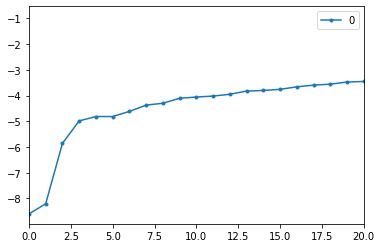

In [83]:
scores = pd.DataFrame(np.sort(df_scores))
scores.plot(stacked = True, xlim=[0,20],style = '.-')
plt.show(block = True)

* eğimin en dik olduğu değişimin ilk gözlemlendiği yere bakacaksın -> eşik değer
* bir yorum yapıyorum ve 3. değeri seçiyorum

In [84]:
th = np.sort(df_scores)[3]
th

-4.984151747711709

üstekinden daha - değer olanları aykırı değer olarak belirleyeceğim

In [85]:
df[df_scores < th]

df[df_scores < th].shape


(3, 7)

bunlar acaba neden aykırı ?

In [86]:
df.describe([0.01,0.05,0.75,0.90,0.99]).T

,count,mean,std,min,1%,5%,50%,75%,90%,99%,max
carat,53940.000,0.798,0.474,0.200,0.240,0.300,0.700,1.040,1.510,2.180,5.010
depth,53940.000,61.749,1.433,43.000,57.900,59.300,61.800,62.500,63.300,65.600,79.000
table,53940.000,57.457,2.234,43.000,53.000,54.000,57.000,59.000,60.000,64.000,95.000
price,53940.000,3932.800,3989.440,326.000,429.000,544.000,2401.000,5324.250,9821.000,17378.220,18823.000
x,53940.000,5.731,1.122,0.000,4.020,4.290,5.700,6.540,7.310,8.360,10.740
y,53940.000,5.735,1.142,0.000,4.040,4.300,5.710,6.540,7.300,8.340,58.900
z,53940.000,3.539,0.706,0.000,2.480,2.650,3.530,4.040,4.520,5.150,31.800


* mesala 79 almış bir değeri fakat karşılığını denkleştirecek bir değer yok çoklu değişkeni sağlyacak o yüzden
* 78.2 alıyor çünkü price ile ilişkili

In [87]:
df[df_scores < th].index

Int64Index([41918, 48410, 49189], dtype='int64')

silebiliriz aykırıları

In [88]:
df[df_scores < th].drop(axis=0, labels=df[df_scores < th].index)

,carat,depth,table,price,x,y,z


* baskılayabiliriz -> aykırılığın yerine başka gözlem koymamız gerek / eğer çok gözlem sayısı olursa bozulmalar olabilir(deneme)
* agaç yöntemi ise hiç dokunma ya da trasholders kullan -> aykırılara dokunma
*  gözlem sayısı az ise baskılama kullanabilirsin
*  doğrusal yöntemler kullanıyorsak aykırı yöntemler tüm ciddiyetini koruyor demektir

# **MISSING VALUES**

### Ne demek ?
* Gözlemlerde eksik olması durumunu ifade etmektedir.

### Eksik veri problemi nasıl çözülür ?
* 1.silme
* 2.değer atama yöntemleri -> ortalama,median
* 3.tahmine dayalı yöntemler -> istatiksel


### Not :
* eksik veri ile çalışırken göz önünde bulundurulması
* gereken önemli konulardan birisi : Eksik verinin rassallığı(rastgele ortaya çıkıp çıkmadığı)

### Not2 :
* eksik değerlere sahip gözlemlerin veri setinden direkt çıkarılması ve rassallığının incelenmemesi,
* yapılacak istatiksel çıkarımların ve modelleme çalışmalarının güvenilirliğini düşürecektir

### Not3 :
* eksik gözlemlerin veri setinden direkt çıkarılabilmesi için veri setindeki eksikliğin bazı durumlarda kısmen
* bazı durumlarda tamamen rastlantısal olarak oluşmuş olması gerekmektedir.
* Eğer eksiklikler değişkenler ile ilişkili olarak ortaya çıka yapısal problemler ile meydana gelmiş ise bu durumda
* yapılacak silme işlemleri ciddi yanlılıklara sebep olabilecektir.


* kısaca NA ler rastgele çıktıysa sorun yok ister sileriz , ister atarız
* NA = 0
* başka değerlerle ilişkisine bakılır değiştirmeden önce / rastgele değilse dikkatli ol


# Eksik Değerleri Yakalama

verilerin tamamında eksik değer var mı yok mu ? hızlı sorusunu sor

In [89]:
df.isnull().values.any()

False

değişkenlerdeki eksik değer sayısı

In [90]:
df.isnull().sum()

carat    0
depth    0
table    0
price    0
x        0
y        0
z        0
dtype: int64

true 1 false 0

değişkenlerdeki tam değer sayısı

In [91]:
df.isnull().sum()

carat    0
depth    0
table    0
price    0
x        0
y        0
z        0
dtype: int64

veri setindeki toplam eksik değer sayısı

In [92]:
df.isnull().sum().sum()

0

en az bir tane eksik değere sahip olan gözlem birimleri

In [93]:
df[df.isnull().any(axis=1)]

,carat,depth,table,price,x,y,z


tam olan gözlem birimleri

In [94]:
df[df.notnull().all(axis=1)]

,carat,depth,table,price,x,y,z
0,0.230,61.500,55.000,326,3.950,3.980,2.430
1,0.210,59.800,61.000,326,3.890,3.840,2.310
2,0.230,56.900,65.000,327,4.050,4.070,2.310
3,0.290,62.400,58.000,334,4.200,4.230,2.630
4,0.310,63.300,58.000,335,4.340,4.350,2.750
5,0.240,62.800,57.000,336,3.940,3.960,2.480
6,0.240,62.300,57.000,336,3.950,3.980,2.470
7,0.260,61.900,55.000,337,4.070,4.110,2.530
8,0.220,65.100,61.000,337,3.870,3.780,2.490
9,0.230,59.400,61.000,338,4.000,4.050,2.390


indexlerine eriş

In [95]:
df[df.isnull().any(axis=1)].index

Int64Index([], dtype='int64')

azalan şekilde sıralamak

In [96]:
df.isnull().sum().sort_values(ascending = False)

carat    0
depth    0
table    0
price    0
x        0
y        0
z        0
dtype: int64

eksikliğin veri setindeki oranı

In [97]:
(df.isnull().sum() / df.shape[0]*100).sort_values(ascending=False)

carat   0.000
depth   0.000
table   0.000
price   0.000
x       0.000
y       0.000
z       0.000
dtype: float64

sadece eksik değere sahip olan değişkenleri seçme yöntemi

In [98]:
na_cols = [col for col in df.columns if df[col].isnull().sum() > 0 ]
na_cols

[]

bunların hepsini tek fonksiyonda yaz

In [99]:
def missing_values_table(dataframe,na_name = False):
    na_columns = [col for col in dataframe.columns if dataframe[col].isnull().sum() > 0]

    n_miss = dataframe[na_columns].isnull().sum().sort_values(ascending=False)
    ratio = (dataframe[na_columns].isnull().sum() / dataframe.shape[0] * 100).sort_values(ascending=False)
    missing_df = pd.concat([n_miss,np.round(ratio,2)], axis=1, keys=['n_miss','ratio'])
    print(missing_df,end="\n")

    if na_name:
        return na_columns

In [100]:
missing_values_table(df)

Empty DataFrame
Columns: [n_miss, ratio]
Index: []


eksik değerlerin isimleri

In [101]:
missing_values_table(df, True)

Empty DataFrame
Columns: [n_miss, ratio]
Index: []


[]

# Eksik Değer Problemini Çözme

* eğer ağaca dayalı yöntem kullanılırsa eksik değerler göz ardı edilebilir
* bağımlı değişkenlerden dolayı işlemler uzayabilir





Çözüm 1: Hızlıca Silmek

In [102]:
df.dropna().shape

(53940, 7)

Çözüm 2: Basit Atama Yöntemleri ile Doldurmak

In [105]:
def load():
    data = pd.read_csv('/titanic.csv')
    return data  

In [106]:
df = load() 
df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S


In [107]:
df["Age"].fillna(df["Age"].mean())

0     22.000
1     38.000
2     26.000
3     35.000
4     35.000
5     29.699
6     54.000
7      2.000
8     27.000
9     14.000
10     4.000
11    58.000
12    20.000
13    39.000
14    14.000
15    55.000
16     2.000
17    29.699
18    31.000
19    29.699
20    35.000
21    34.000
22    15.000
23    28.000
24     8.000
25    38.000
26    29.699
27    19.000
28    29.699
29    29.699
30    40.000
31    29.699
32    29.699
33    66.000
34    28.000
35    42.000
36    29.699
37    21.000
38    18.000
39    14.000
40    40.000
41    27.000
42    29.699
43     3.000
44    19.000
45    29.699
46    29.699
47    29.699
48    29.699
49    18.000
50     7.000
51    21.000
52    49.000
53    29.000
54    65.000
55    29.699
56    21.000
57    28.500
58     5.000
59    11.000
60    22.000
61    38.000
62    45.000
63     4.000
64    29.699
65    29.699
66    29.000
67    19.000
68    17.000
69    26.000
70    32.000
71    16.000
72    21.000
73    26.000
74    32.000
75    25.000
76    29.699

In [108]:
df["Age"].fillna(df["Age"].mean()).isnull().sum()

0

sabit bir değerle doldurma/eksik değer yerine 0 yazmak

In [109]:
df["Age"].fillna(0).isnull().sum()

0

* birçok işlem olursa napacağım ?
* apply ve lambda kullanılabilir

In [110]:
#df.apply(lambda x:x.fillna(x.mean()), axis=0)

* öyle bir işlem yapmalıyım ki sadece sayısal değişkenlerle doldursun
* bu işlem eğer objecten farklı ise 0 ile doldur
* farklı değilse olduğu gibi kalsın

In [111]:
df.apply(lambda x:x.fillna(x.mean) if x.dtype != "0" else x , axis=0).head()
dff = df.apply(lambda x:x.fillna(x.mean) if x.dtype != "0" else x , axis=0).head()

In [112]:
dff

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,<bound method NDFrame._add_numeric_operations....,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,<bound method NDFrame._add_numeric_operations....,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,<bound method NDFrame._add_numeric_operations....,S


In [113]:
dff.isnull().sum().sort_values(ascending=False)

PassengerId    0
Survived       0
Pclass         0
Name           0
Sex            0
Age            0
SibSp          0
Parch          0
Ticket         0
Fare           0
Cabin          0
Embarked       0
dtype: int64

Not : kategorik değişkenler için en mantıklı doldurma yöntemlerden birisi "mod"unu almak 
* embarked ile doldur

In [114]:
df["Embarked"].fillna(df["Embarked"].mode()[0])

0      S
1      C
2      S
3      S
4      S
5      Q
6      S
7      S
8      S
9      C
10     S
11     S
12     S
13     S
14     S
15     S
16     Q
17     S
18     S
19     C
20     S
21     S
22     Q
23     S
24     S
25     S
26     C
27     S
28     Q
29     S
30     C
31     C
32     Q
33     S
34     C
35     S
36     C
37     S
38     S
39     C
40     S
41     S
42     C
43     C
44     Q
45     S
46     Q
47     Q
48     C
49     S
50     S
51     S
52     C
53     S
54     C
55     S
56     S
57     C
58     S
59     S
60     C
61     S
62     S
63     S
64     C
65     C
66     S
67     S
68     S
69     S
70     S
71     S
72     S
73     C
74     S
75     S
76     S
77     S
78     S
79     S
80     S
81     S
82     Q
83     S
84     S
85     S
86     S
87     S
88     S
89     S
90     S
91     S
92     S
93     S
94     S
95     S
96     C
97     C
98     S
99     S
100    S
101    S
102    S
103    S
104    S
105    S
106    S
107    S
108    S
109    Q
110    S
1

In [115]:
df["Embarked"].fillna(df["Embarked"].mode()[0]).isnull().sum()

0

* eğer dilerseniz herhangi ifade kullanabilirsiniz
* daha sonra analiz edip durum değerlendirmesi yapacaksınız

In [116]:
df["Embarked"].fillna("missing")

0            S
1            C
2            S
3            S
4            S
5            Q
6            S
7            S
8            S
9            C
10           S
11           S
12           S
13           S
14           S
15           S
16           Q
17           S
18           S
19           C
20           S
21           S
22           Q
23           S
24           S
25           S
26           C
27           S
28           Q
29           S
30           C
31           C
32           Q
33           S
34           C
35           S
36           C
37           S
38           S
39           C
40           S
41           S
42           C
43           C
44           Q
45           S
46           Q
47           Q
48           C
49           S
50           S
51           S
52           C
53           S
54           C
55           S
56           S
57           C
58           S
59           S
60           C
61     missing
62           S
63           S
64           C
65           C
66        

otomatik olarak yapma

In [117]:
df.apply(lambda x:x.fillna(x.mode()[0]) if(x.dtype == "0" and len(x.unique()) <= 10)else x, axis=0).isnull().sum()

PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Age            177
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          687
Embarked         2
dtype: int64

# Kategorik Değişken Kırılımında Değer Atama

veri setindeki bazı kategorik değişkenleri ele almak ve bunları veri setinde

In [118]:
df.groupby("Sex")["Age"].mean()

Sex
female   27.916
male     30.727
Name: Age, dtype: float64

sadece yaşın ort

In [119]:
df["Age"].mean()

29.69911764705882

her iki cinsiyetinde yaş ortalaması farklı olduğundan cinsiyete göre değer atamak daha doğru

* programatik şekilde yapımı
* erkekleri ve kadınları ayrı ayrı alacağız
* kadın ve erkeğe göre groupby alıp yaş ortalamasını hesaplamalıyım
* yaş ortalamasını da cinsiyet kırılımına göre uyarlayalım

In [120]:
df["Age"].fillna(df.groupby("Sex")["Age"].transform("mean")).isnull().sum()

0

daha açık şekilde yapalım 

yaş değişkenin de eksiklik olup cinsiyeti kadın olanı getirdi

In [121]:
df.loc[(df["Age"].isnull()) & (df["Sex"] == "female")]

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
19,20,1,3,"Masselmani, Mrs. Fatima",female,NaN,0,0,2649,7.225,NaN,C
28,29,1,3,"O'Dwyer, Miss. Ellen ""Nellie""",female,NaN,0,0,330959,7.879,NaN,Q
31,32,1,1,"Spencer, Mrs. William Augustus (Marie Eugenie)",female,NaN,1,0,PC 17569,146.521,B78,C
32,33,1,3,"Glynn, Miss. Mary Agatha",female,NaN,0,0,335677,7.750,NaN,Q
47,48,1,3,"O'Driscoll, Miss. Bridget",female,NaN,0,0,14311,7.750,NaN,Q
82,83,1,3,"McDermott, Miss. Brigdet Delia",female,NaN,0,0,330932,7.787,NaN,Q
109,110,1,3,"Moran, Miss. Bertha",female,NaN,1,0,371110,24.150,NaN,Q
128,129,1,3,"Peter, Miss. Anna",female,NaN,1,1,2668,22.358,F E69,C
140,141,0,3,"Boulos, Mrs. Joseph (Sultana)",female,NaN,0,2,2678,15.246,NaN,C
166,167,1,1,"Chibnall, Mrs. (Edith Martha Bowerman)",female,NaN,0,1,113505,55.000,E33,S


kadınlara yönelik groupby

In [122]:
df.groupby("Sex")["Age"].mean()["female"]

27.915708812260537

yukardaki ikisin birleştiriyoruz

In [123]:
df.loc[(df["Age"].isnull()) & (df["Sex"] == "female"),"Age"] = df.groupby("Sex")["Age"].mean()["female"]

erkekler için de aynı işlemi yapalım

In [124]:
df.loc[(df["Age"].isnull()) & (df["Sex"] == "male"),"Age"] = df.groupby("Sex")["Age"].mean()["male"]

ksik değer var mı bakalım

In [125]:
df.isnull().sum()

PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Age              0
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          687
Embarked         2
dtype: int64

# Çözüm 3: Tahmine Dayalı Atama İle Doldurma

gelişmiş yöntemlerle eksiklikleri doldurmak

* modelleme işlemi yapacağız
* onehub encoder
* bir standard oluşturacağız ona uymak lazım (KNN)


In [126]:
df = load()

In [127]:
def grab_col_names(dataframe, cat_th=10, car_th=20):
    cat_cols = [col for col in dataframe.columns if dataframe[col].dtypes == "0"]
    num_but_cat = [col for col in dataframe.columns if dataframe[col].nunique()<cat_th and
            dataframe[col].dtypes !="0"]
    cat_but_car = [col for col in dataframe.columns if dataframe[col].nunique() > car_th and
                dataframe[col].dtypes == "0"]

    cat_cols = cat_cols + num_but_cat
    cat_cols = [col for col in cat_cols if col not in cat_but_car]


# num_cols
    num_cols = [col for col in  dataframe.columns if dataframe[col].dtypes in ["int","float"] ]
    num_cols = [col for col in num_cols if col not in cat_cols]

    print(f"Observations:{dataframe.shape[0]}")
    print(f"Variables:{dataframe.shape[1]}")
    print(f'cat_cols:"{len(cat_cols)}')
    print(f'num_cols:"{len(num_cols)}')
    print(f'cat_but_car:"{len(cat_but_car)}')
    print(f'num_but_cat:"{len(num_but_cat)}')
    return cat_cols,num_cols,cat_but_car



cat_cols,num_cols,cat_but_car  = grab_col_names(df)

Observations:891
Variables:12
cat_cols:"6
num_cols:"3
cat_but_car:"0
num_but_cat:"6


In [128]:
num_cols = [col for col in num_cols if col not in "PassengerId"]

In [129]:
num_cols

['Age', 'Fare']

* cat_cols lara dönüşüm işlemi yapmam gerek encoder olması lazım = label encoding,onehub encoding
 onehut
* binary şekilde gösterecek /numeric
* sadece kategorik değişkenleri çevirir
* 3 olanları dokunmuyoruz şimdilik

In [130]:
dff = pd.get_dummies(df[cat_cols + num_cols],drop_first=True)

dff.head()

,Survived,Pclass,SibSp,Parch,Age,Fare,Sex_male,Embarked_Q,Embarked_S
0,0,3,1,0,22.000,7.250,1,0,1
1,1,1,1,0,38.000,71.283,0,0,0
2,1,3,0,0,26.000,7.925,0,0,1
3,1,1,1,0,35.000,53.100,0,0,1
4,0,3,0,0,35.000,8.050,1,0,1


standartlaştırmam gerekiyor kıyaslamak için

In [131]:
scaler = MinMaxScaler()
dff = pd.DataFrame(scaler.fit_transform(dff),columns=dff.columns)

In [132]:
dff.head()

,Survived,Pclass,SibSp,Parch,Age,Fare,Sex_male,Embarked_Q,Embarked_S
0,0.000,1.000,0.125,0.000,0.271,0.014,1.000,0.000,1.000
1,1.000,0.000,0.125,0.000,0.472,0.139,0.000,0.000,0.000
2,1.000,1.000,0.000,0.000,0.321,0.015,0.000,0.000,1.000
3,1.000,0.000,0.125,0.000,0.435,0.104,0.000,0.000,1.000
4,0.000,1.000,0.000,0.000,0.435,0.016,1.000,0.000,1.000



* KNN'in uygulanması/eksik değerleri doldurmak için
* KNN : bana arkadaşını söyle sana kim olduğunu söylim
* yaş değişkenindeki eksik değerlerindeki en yakın 5 komşusunu baz alacak
* en yakın 5 komşunun yaş ortalamasını alacak

In [133]:
from sklearn.impute import KNNImputer


model nesnesi oluşturulur

In [134]:
imputer  = KNNImputer(n_neighbors=5)
dff = pd.DataFrame(imputer.fit_transform(dff), columns=dff.columns)
dff.head()

,Survived,Pclass,SibSp,Parch,Age,Fare,Sex_male,Embarked_Q,Embarked_S
0,0.000,1.000,0.125,0.000,0.271,0.014,1.000,0.000,1.000
1,1.000,0.000,0.125,0.000,0.472,0.139,0.000,0.000,0.000
2,1.000,1.000,0.000,0.000,0.321,0.015,0.000,0.000,1.000
3,1.000,0.000,0.125,0.000,0.435,0.104,0.000,0.000,1.000
4,0.000,1.000,0.000,0.000,0.435,0.016,1.000,0.000,1.000


doldurduğum yerleri görmek istiyorum
* gerçek değer değil standartlaştırılmış değerler
* standartlaştırılmış değerleri geri alacam
* scaler.inverse_transform(dff)

In [135]:
dff = pd.DataFrame(scaler.inverse_transform(dff),columns=dff.columns)
dff.head()

,Survived,Pclass,SibSp,Parch,Age,Fare,Sex_male,Embarked_Q,Embarked_S
0,0.000,3.000,1.000,0.000,22.000,7.250,1.000,0.000,1.000
1,1.000,1.000,1.000,0.000,38.000,71.283,0.000,0.000,0.000
2,1.000,3.000,0.000,0.000,26.000,7.925,0.000,0.000,1.000
3,1.000,1.000,1.000,0.000,35.000,53.100,0.000,0.000,1.000
4,0.000,3.000,0.000,0.000,35.000,8.050,1.000,0.000,1.000


kıyaslamam lazım

In [136]:
df["age_imputed_knn"] = dff[["Age"]]

In [137]:
df.loc[df["Age"].isnull(),["Age","age_imputed_knn"]]

,Age,age_imputed_knn
5,NaN,47.800
17,NaN,37.600
19,NaN,12.200
26,NaN,32.800
28,NaN,17.600
29,NaN,24.400
31,NaN,29.600
32,NaN,17.600
36,NaN,21.800
42,NaN,28.700


detaylı incelemek için

In [138]:
df.loc[df["Age"].isnull()]

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,age_imputed_knn
5,6,0,3,"Moran, Mr. James",male,NaN,0,0,330877,8.458,NaN,Q,47.800
17,18,1,2,"Williams, Mr. Charles Eugene",male,NaN,0,0,244373,13.000,NaN,S,37.600
19,20,1,3,"Masselmani, Mrs. Fatima",female,NaN,0,0,2649,7.225,NaN,C,12.200
26,27,0,3,"Emir, Mr. Farred Chehab",male,NaN,0,0,2631,7.225,NaN,C,32.800
28,29,1,3,"O'Dwyer, Miss. Ellen ""Nellie""",female,NaN,0,0,330959,7.879,NaN,Q,17.600
29,30,0,3,"Todoroff, Mr. Lalio",male,NaN,0,0,349216,7.896,NaN,S,24.400
31,32,1,1,"Spencer, Mrs. William Augustus (Marie Eugenie)",female,NaN,1,0,PC 17569,146.521,B78,C,29.600
32,33,1,3,"Glynn, Miss. Mary Agatha",female,NaN,0,0,335677,7.750,NaN,Q,17.600
36,37,1,3,"Mamee, Mr. Hanna",male,NaN,0,0,2677,7.229,NaN,C,21.800
42,43,0,3,"Kraeff, Mr. Theodor",male,NaN,0,0,349253,7.896,NaN,C,28.700


#RECAP 

# 1. veriyi yükledik
# 2. eksik veriyi raporladık
# 3. sayısal değişkenleri ortalama veya median ile değiştirdik
# 4. kategorik değişkenleri modu ile doldurduk
# 5. kategorik değişken kırılımında sayısal değişkenleri doldurmak
# 6. tahmine dayalı atama ile doldurma

# Gelişmiş Analizle


bar yöntemi tam sayıları vermektedir

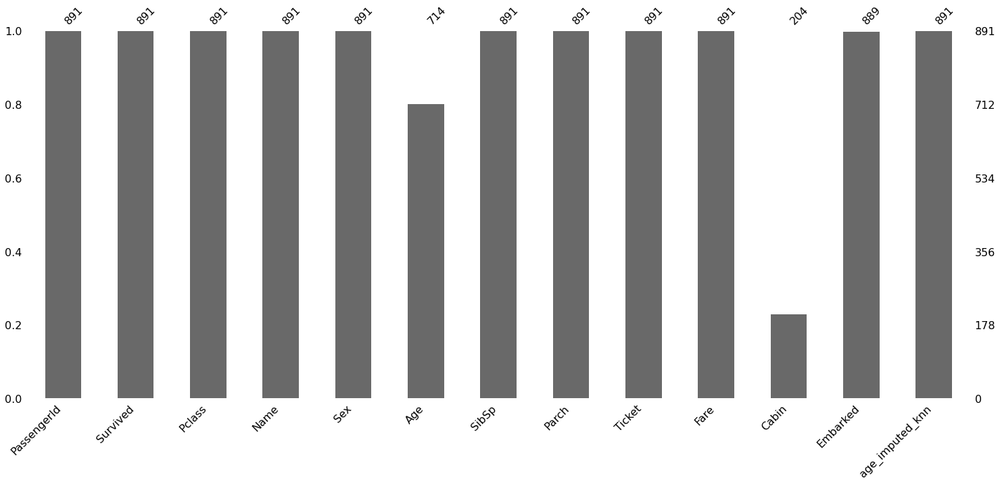

In [139]:
msno.bar(df)
plt.show(block=True)

matrix methodu

* görseldek eksiklikliklerin bir araya çıkma durumunu görsel bir araçtır
* mesala age değişkenindeki siyah veya beyaz yapıların başka bir değişken olan sex değişkeninde de aynı şekilde noktaların,
* boşlukların olmasını bekleriz.

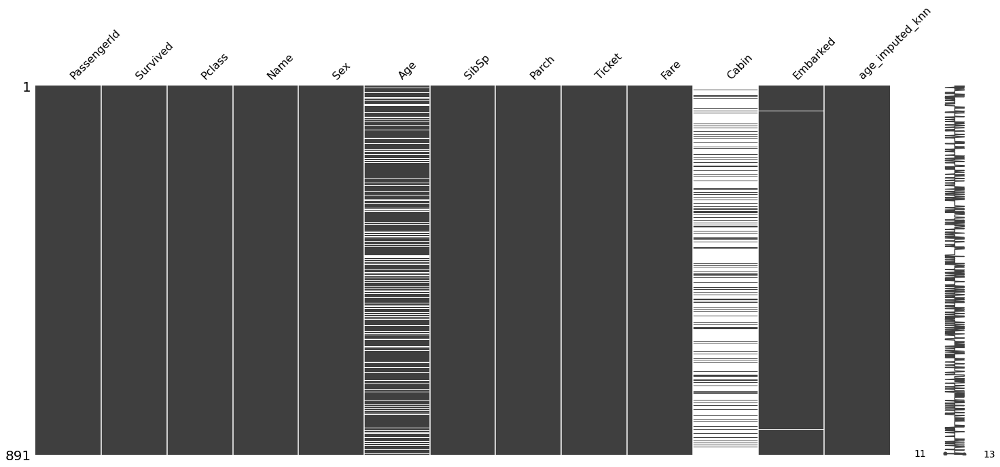

In [140]:
msno.matrix(df)
plt.show(block=True)

# heatmap 

* ısı haritası
* eksik değerlerin belirli korelasyonla çıkıp çıkmadığına bakıyoruz
* eksikliklerin bağımlı olma durumu ve birlikte çıkma durumu
* iki değişkenin birlikte eksiliyor olması
* +1 e yakın olması pozitif yönlü kuvvetli ilişki -> eksiklikler birlikte ortaya çıkmıştır
* -1 e yakın olması negatif yönlü kuvvetli ilişki -> birisinde yokken diğerinde vardır ters ilişki


bu veri seti anlamlı gözükmüyor -1 e yakın

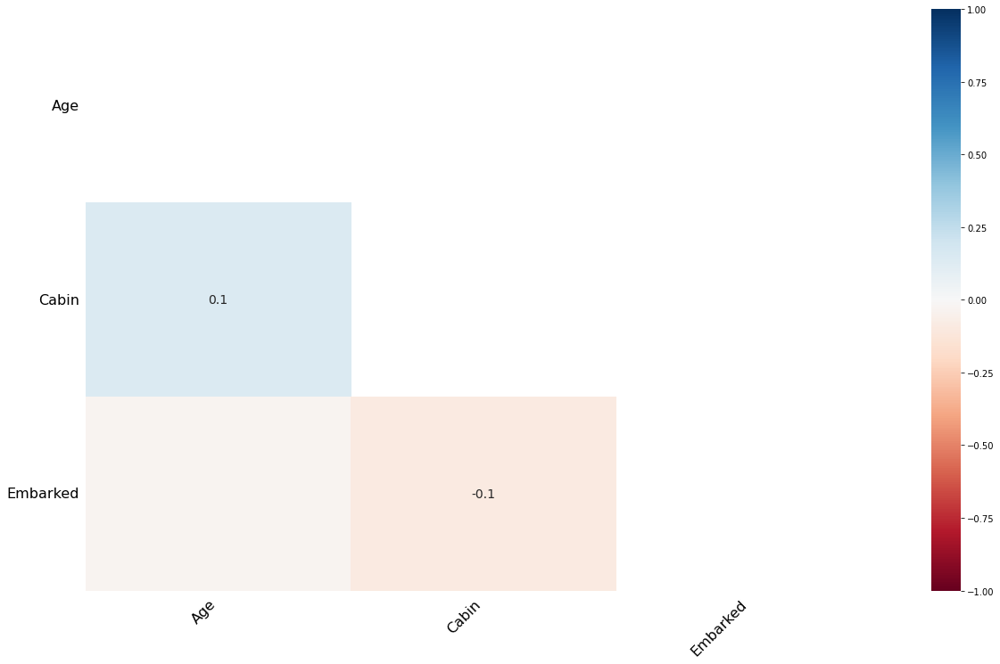

In [141]:
msno.heatmap(df)
plt.show(block=True)


# Eksik Değerlerin Bağımlı Değişken İle İlişkisinin İncelenmesi

* amacım : bir veri seti var ve bu veri setinde eksiklikler var,acaba bu eksikliklerin bağımlı değişkenlerle ilişksi var mı
* yoksa özel bir yapı mı ?


In [142]:
missing_values_table(df,True)
na_cols = missing_values_table(df,True)

          n_miss  ratio
Cabin        687 77.100
Age          177 19.870
Embarked       2  0.220
          n_miss  ratio
Cabin        687 77.100
Age          177 19.870
Embarked       2  0.220


In [143]:
def missing_vs_target(dataframe,target,na_columns):
    temp_df = dataframe.copy()
    for col in na_columns:
        temp_df[col + '_NA_FLAG'] = np.where(temp_df[col].isnull(),1,0)
    na_flags = temp_df.loc[:,temp_df.columns.str.contains("_NA_")].columns
    for col in na_flags:
        print(pd.DataFrame({"TARGET_MEAN":temp_df.groupby(col)[target].mean(),
                            "Count":temp_df.groupby(col)[target].count()}), end="\n\n\n")

In [144]:
missing_vs_target(df,"Survived",na_cols)

             TARGET_MEAN  Count
Age_NA_FLAG                    
0                  0.406    714
1                  0.294    177


               TARGET_MEAN  Count
Cabin_NA_FLAG                    
0                    0.667    204
1                    0.300    687


                  TARGET_MEAN  Count
Embarked_NA_FLAG                    
0                       0.382    889
1                       1.000      2




dipnot : çalışanların kabin numarası yok sadece yolcuların var

* target ilgili veri değişkenindeki bağımlı değişken -> survived
* eksiklik varsa eksiklik gördüğün yere 1 diğerine 0
* temp i oluşturma amacım orjinal dataframemi bozmamak için copy oluşturdum

# RECAP

Dipnot: sayısal değişkenleri direk median ile oldurma nedeni ise ortalama ile yaparsak yüksek ortalama aykırılığı etkiliyor / yükseltiyor ortlamayı 

In [149]:
def load_application_train():
    data = pd.read_csv('/application_train.csv')
    return data   

In [150]:
df = load_application_train()

In [151]:
df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.000,406597.500,24700.500,351000.000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.019,-9461,-637,-3648.000,-2120,NaN,1,1,0,1,1,0,Laborers,1.000,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083,0.263,0.139,0.025,0.037,0.972,0.619,0.014,0.000,0.069,0.083,0.125,0.037,0.020,0.019,0.000,0.000,0.025,0.038,0.972,0.634,0.014,0.000,0.069,0.083,0.125,0.038,0.022,0.020,0.000,0.000,0.025,0.037,0.972,0.624,0.014,0.000,0.069,0.083,0.125,0.037,0.021,0.019,0.000,0.000,reg oper account,block of flats,0.015,"Stone, brick",No,2.000,2.000,2.000,2.000,-1134.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000
1,100003,0,Cash loans,F,N,N,0,270000.000,1293502.500,35698.500,1129500.000,Family,State servant,Higher education,Married,House / apartment,0.004,-16765,-1188,-1186.000,-291,NaN,1,1,0,1,1,0,Core staff,2.000,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311,0.622,NaN,0.096,0.053,0.985,0.796,0.060,0.080,0.035,0.292,0.333,0.013,0.077,0.055,0.004,0.010,0.092,0.054,0.985,0.804,0.050,0.081,0.035,0.292,0.333,0.013,0.079,0.055,0.000,0.000,0.097,0.053,0.985,0.799,0.061,0.080,0.035,0.292,0.333,0.013,0.079,0.056,0.004,0.010,reg oper account,block of flats,0.071,Block,No,1.000,0.000,1.000,0.000,-828.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
2,100004,0,Revolving loans,M,Y,Y,0,67500.000,135000.000,6750.000,135000.000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010,-19046,-225,-4260.000,-2531,26.000,1,1,1,1,1,0,Laborers,1.000,2,2,MONDAY,9,0,0,0,0,0,0

In [152]:
na_cols = missing_values_table(df,True)
df.apply(lambda x:x.fillna(x.median()) if x.dtype != "0" else x , axis = 0).isnull().sum()

                              n_miss  ratio
COMMONAREA_AVG                146586 69.920
COMMONAREA_MODE               146586 69.920
COMMONAREA_MEDI               146586 69.920
NONLIVINGAPARTMENTS_AVG       145577 69.440
NONLIVINGAPARTMENTS_MEDI      145577 69.440
NONLIVINGAPARTMENTS_MODE      145577 69.440
FONDKAPREMONT_MODE            143405 68.400
LIVINGAPARTMENTS_MODE         143362 68.380
LIVINGAPARTMENTS_MEDI         143362 68.380
LIVINGAPARTMENTS_AVG          143362 68.380
FLOORSMIN_MODE                142303 67.870
FLOORSMIN_MEDI                142303 67.870
FLOORSMIN_AVG                 142303 67.870
YEARS_BUILD_AVG               139438 66.510
YEARS_BUILD_MEDI              139438 66.510
YEARS_BUILD_MODE              139438 66.510
OWN_CAR_AGE                   138421 66.020
LANDAREA_MEDI                 124590 59.430
LANDAREA_MODE                 124590 59.430
LANDAREA_AVG                  124590 59.430
BASEMENTAREA_AVG              122809 58.580
BASEMENTAREA_MEDI             12

TypeError: ignored

In [153]:
# kategorik değişkenleri mode ile doldurma
df.apply(lambda x: x.fillna(x.mode()[0]) if (x.dtype == "0" and len(x.unique()) <= 10)else x, axis=0).isnull().sum()

SK_ID_CURR                           0
TARGET                               0
NAME_CONTRACT_TYPE                   0
CODE_GENDER                          0
FLAG_OWN_CAR                         0
FLAG_OWN_REALTY                      0
CNT_CHILDREN                         0
AMT_INCOME_TOTAL                     0
AMT_CREDIT                           0
AMT_ANNUITY                          9
AMT_GOODS_PRICE                    171
NAME_TYPE_SUITE                    862
NAME_INCOME_TYPE                     0
NAME_EDUCATION_TYPE                  0
NAME_FAMILY_STATUS                   0
NAME_HOUSING_TYPE                    0
REGION_POPULATION_RELATIVE           0
DAYS_BIRTH                           0
DAYS_EMPLOYED                        0
DAYS_REGISTRATION                    0
DAYS_ID_PUBLISH                      0
OWN_CAR_AGE                     138421
FLAG_MOBIL                           0
FLAG_EMP_PHONE                       0
FLAG_WORK_PHONE                      0
FLAG_CONT_MOBILE         

In [157]:
def load():
    data = pd.read_csv('/titanic.csv')
    return data  

In [158]:
df = load()

In [159]:
df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S


In [160]:
# kategorik değişken kırılımında sayısal değişkenleri doldurmak
df["Age"].fillna(df.groupby("Sex")["Age"].transform("mean")).isnull().sum()

0

In [162]:
def load():
    data = pd.read_csv('/titanic.csv')
    return data  

In [163]:
df = load()

In [164]:
# tahmine dayalı atama ile doldurma
# missing_vs_target(df,"Survived",na_cols)

# Encoding

Ne Demek ?

* Değişkenlerin temsil şekillerinin değiştirilmesi
* Label Encoding:  -> yeniden kodlamak temsil ettirmek
* sex : male-female-male-male-female
* is_female :  0-1 male : 0 female : 1

* farklılığa göre label encoding oluyor sınıflar arası farklılıklar olmalı
* yaş-cinsiyet-ünvan vs



# 3.Encoding (Label Encoding, One-Hot Encoding, Rare Encoding )

Label Encoding & Binary Encoding


In [165]:
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt

#!pip install missingo
# conda install missingno

import missingno as msno
from datetime import date
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.neighbors import LocalOutlierFactor
from sklearn.preprocessing import MinMaxScaler, LabelEncoder, StandardScaler, RobustScaler

pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)
pd.set_option('display.float_format',lambda x: '%.3f'%x)
pd.set_option('display.width',500)

In [166]:
def load():
    data = pd.read_csv('/titanic.csv')
    return data  

In [167]:
df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S


In [168]:
df["Sex"].head()

0      male
1    female
2    female
3    female
4      male
Name: Sex, dtype: object

cinsiyeti 0-1 olarak kodlayalım

In [169]:
le = LabelEncoder()
le.fit_transform(df["Sex"])[0:5]

array([1, 0, 0, 0, 1])

* ilk gördüğü değere 0 verir(alfabetik sıraya göre 0 -1 ) 
* hangi sınıf olduğunu unuttuk hangisi 0 hangisi 1

In [170]:
le.inverse_transform([0,1])

array(['female', 'male'], dtype=object)

bu tercih edilir/fonksiyon yazılır

In [172]:
def label_encoder(dataframe, binary_col):
    labelencoder = LabelEncoder()
    dataframe[binary_col] = labelencoder.fit_transform((dataframe[binary_col]))
    return  dataframe


* yüzlerce veri varsa binary_collar seçilir

* 2 sınıflı kategorik değişkenleri label_encoderdan geçireceğiz

In [173]:
binary_cols = [col for col in df.columns if df[col].dtype not in [int,float]
            and df[col].nunique() == 2]

In [174]:
binary_cols

['Sex']

diyelim ki 10 tane vardı

application_train_csv için de yapalım

In [175]:
def label_encoder(dataframe, binary_col):
    labelencoder = LabelEncoder()
    dataframe[binary_col] = labelencoder.fit_transform((dataframe[binary_col]))
    return  dataframe

In [176]:
binary_cols

['Sex']

In [177]:
df[binary_cols].head()

,Sex
0,male
1,female
2,female
3,female
4,male


In [178]:
binary_cols = [col for col in df.columns if df[col].dtype not in [int,float]
            and df[col].nunique() == 2]

In [179]:
for col in binary_cols:
    label_encoder(df,col)

binary_cols

['Sex']

In [180]:
df[binary_cols].head()

,Sex
0,1
1,0
2,0
3,0
4,1


In [181]:
df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",1,22.000,1,0,A/5 21171,7.250,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",0,38.000,1,0,PC 17599,71.283,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",0,26.000,0,0,STON/O2. 3101282,7.925,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",0,35.000,1,0,113803,53.100,C123,S
4,5,0,3,"Allen, Mr. William Henry",1,35.000,0,0,373450,8.050,NaN,S


application_train_csv için de yapalım

In [183]:
def load_application_train():
    data = pd.read_csv('/application_train.csv')
    return data  

In [184]:
df = load_application_train()

In [185]:
df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.000,406597.500,24700.500,351000.000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.019,-9461,-637,-3648.000,-2120,NaN,1,1,0,1,1,0,Laborers,1.000,2.000,2.000,WEDNESDAY,10.000,0.000,0.000,0.000,0.000,0.000,0.000,Business Entity Type 3,0.083,0.263,0.139,0.025,0.037,0.972,0.619,0.014,0.000,0.069,0.083,0.125,0.037,0.020,0.019,0.000,0.000,0.025,0.038,0.972,0.634,0.014,0.000,0.069,0.083,0.125,0.038,0.022,0.020,0.000,0.000,0.025,0.037,0.972,0.624,0.014,0.000,0.069,0.083,0.125,0.037,0.021,0.019,0.000,0.000,reg oper account,block of flats,0.015,"Stone, brick",No,2.000,2.000,2.000,2.000,-1134.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000
1,100003,0,Cash loans,F,N,N,0,270000.000,1293502.500,35698.500,1129500.000,Family,State servant,Higher education,Married,House / apartment,0.004,-16765,-1188,-1186.000,-291,NaN,1,1,0,1,1,0,Core staff,2.000,1.000,1.000,MONDAY,11.000,0.000,0.000,0.000,0.000,0.000,0.000,School,0.311,0.622,NaN,0.096,0.053,0.985,0.796,0.060,0.080,0.035,0.292,0.333,0.013,0.077,0.055,0.004,0.010,0.092,0.054,0.985,0.804,0.050,0.081,0.035,0.292,0.333,0.013,0.079,0.055,0.000,0.000,0.097,0.053,0.985,0.799,0.061,0.080,0.035,0.292,0.333,0.013,0.079,0.056,0.004,0.010,reg oper account,block of flats,0.071,Block,No,1.000,0.000,1.000,0.000,-828.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
2,100004,0,Revolving loans,M,Y,Y,0,67500.000,135000.000,6750.000,135000.000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010,-19046,-225,-4

In [186]:
binary_cols = [col for col in df.columns if df[col].dtype not in [int,float]
            and df[col].nunique() == 2]
binary_cols

['NAME_CONTRACT_TYPE',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'EMERGENCYSTATE_MODE']

na ların farkında ol yani 2 ler

In [187]:
df[binary_cols].head()

,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,EMERGENCYSTATE_MODE
0,Cash loans,N,Y,No
1,Cash loans,N,N,No
2,Revolving loans,Y,Y,NaN
3,Cash loans,N,Y,NaN
4,Cash loans,N,Y,NaN


In [189]:
def load():
    data = pd.read_csv('/titanic.csv')
    return  data 

In [190]:
# na ların farkında ol yani 2 ler 
df = load()
df["Embarked"].value_counts()
df["Embarked"].nunique()
len(df["Embarked"].unique())

4


# 4.One Hot Encoding 


* sınıflar arası fark yokken varmış gibi olacaktır
* gs-ts-fb-bjk aynı -> ben bunları öyle temsil etmeliyim ki durduk yere pek bir fark koymiyim
* sınıfları değişkenlere dönüştürme
* GS = 1 ise diğerleri 0 gibi -> kukla değişkendir / ölçme problemi çıkabilir birbiri üzerinde oluşturabilir
* ilk sınıf drop edilirse problem yaşanmaz

In [191]:
df = load()
df.head()
df["Embarked"].value_counts()

S    644
C    168
Q     77
Name: Embarked, dtype: int64

get_dummies -> bana bir dataframe söyle ben sadece onları dönüştürecem/diğerleri olduğu gibi kalacak 

* GS : 1  FB : 0
* FB : 0  ADS : 1
* TS : 0 
* BJK :0  

aynı sütunda bir tane 1 olur  

* Neden Önemli ? 
* eğer doğrusal regresyon modeli kullanıyorsanız bu dummy değişken tuzağından kurtulmanız gerekecektir

In [192]:
pd.get_dummies(df,columns=["Embarked"]).head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked_C,Embarked_Q,Embarked_S
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,0,0,1
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,1,0,0
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,0,0,1
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,0,0,1
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,0,0,1


drop_first ü kullanacağız dummi ile birbiri üstüne geçmemesi için

In [193]:
pd.get_dummies(df,columns=["Embarked"], drop_first=True).head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked_Q,Embarked_S
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,0,1
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,0,0
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,0,1
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,0,1
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,0,1


eğer ilgili değişkendeki eksik değerlerde gelsin istersek

In [194]:
pd.get_dummies(df,columns=["Embarked"], dummy_na=True).head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked_C,Embarked_Q,Embarked_S,Embarked_nan
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,0,0,1,0
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,1,0,0,0
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,0,0,1,0
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,0,0,1,0
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,0,0,1,0


hepsini tek bir adımda yapmak istersek 
* drop ederek dummyden kurtulacağız

In [195]:
pd.get_dummies(df,columns=["Sex","Embarked"], drop_first=True).head()

,PassengerId,Survived,Pclass,Name,Age,SibSp,Parch,Ticket,Fare,Cabin,Sex_male,Embarked_Q,Embarked_S
0,1,0,3,"Braund, Mr. Owen Harris",22.000,1,0,A/5 21171,7.250,NaN,1,0,1
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",38.000,1,0,PC 17599,71.283,C85,0,0,0
2,3,1,3,"Heikkinen, Miss. Laina",26.000,0,0,STON/O2. 3101282,7.925,NaN,0,0,1
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",35.000,1,0,113803,53.100,C123,0,0,1
4,5,0,3,"Allen, Mr. William Henry",35.000,0,0,373450,8.050,NaN,1,0,1


fonksiyonlaştıralım

In [196]:
def one_hot_encoder(dataframe, categorical_cols, drop_first = False):
    dataframe = pd.get_dummies(dataframe, columns=categorical_cols,drop_first=drop_first)
    return dataframe

In [197]:
df = load()

In [198]:
def grab_col_names(dataframe, cat_th=10, car_th=20):
    cat_cols = [col for col in dataframe.columns if dataframe[col].dtypes == "0"]
    num_but_cat = [col for col in dataframe.columns if dataframe[col].nunique()<cat_th and
            dataframe[col].dtypes !="0"]
    cat_but_car = [col for col in dataframe.columns if dataframe[col].nunique() > car_th and
                dataframe[col].dtypes == "0"]

    cat_cols = cat_cols + num_but_cat
    cat_cols = [col for col in cat_cols if col not in cat_but_car]


# num_cols
    num_cols = [col for col in  dataframe.columns if dataframe[col].dtypes in ["int","float"] ]
    num_cols = [col for col in num_cols if col not in cat_cols]

    print(f"Observations:{dataframe.shape[0]}")
    print(f"Variables:{dataframe.shape[1]}")
    print(f'cat_cols:"{len(cat_cols)}')
    print(f'num_cols:"{len(num_cols)}')
    print(f'cat_but_car:"{len(cat_but_car)}')
    print(f'num_but_cat:"{len(num_but_cat)}')
    return cat_cols,num_cols,cat_but_car

In [199]:
cat_cols,num_cols, cat_but_car = grab_col_names(df)

Observations:891
Variables:12
cat_cols:"6
num_cols:"3
cat_but_car:"0
num_but_cat:"6


yorum : hepsini geçir "survived" dışında kalsın

* one_hot_encoder dan geçecek olan sütunları da seçerek takip edebilirim****
* 2 den büyükse 10 dan küçükse
* bağımlıysa dışarda bırak 
* fazla değişken varsa kullanılmaz


In [200]:
ohe_cols = [col for col in df.columns if 10 >= df[col].nunique() > 2 ]

In [201]:
ohe_cols

['Pclass', 'SibSp', 'Parch', 'Embarked']

kalıcı değil

In [202]:
df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S


kalıcı olması için = df = one_hot_encoder(df,ohe_cols).head()

# Rare Encoding 

Ne demek ?

* az gözlemlenen

* 2-3-5 gibi az gözlemler var bunları napacağız
* büyük çoğunluğu temsil etmek amacımız
* nadir değerleri almayız bize doğru bilgiyi vermez çünkü gözlem sayısı az
* ölçümlerin de kalitesi olsun / gereksiz birçok değişken oluşturmak istemiyoruz
* gereksiz değişkenlerden uzaklaşmamız gerek bu yüzden kullanırız
* tüm işlemlerde kullanılmaz

* Nasıl yapacağız

* bir eşik değeri belirleyeceğiz bunların altındakileri işaretleyeceğiz -> -> RARE diyeceğiz(altındakilere)
 diğer kalanları bir araya getireceğiz 


 Uygulaması  

* 1.Kategorik değişkenlerin azlık çokluk durumunun analiz edilmesi
* 2.Rare kategoriler ile bağımlı değişken arasındaki ilişkinin analiz edilmesi
* 3.Rare encoder yazacağız

# 1. Kategorik değişkenlerin azlık çokluk durumunun analiz edilmesi

In [203]:
df = load_application_train()
df["NAME_EDUCATION_TYPE"].value_counts()

Secondary / secondary special    212237
Higher education                  72776
Incomplete higher                  9998
Lower secondary                    3699
Academic degree                     160
Name: NAME_EDUCATION_TYPE, dtype: int64

* az olan birden fazla sınıfı bir araya getirmekle ilgileniyoruz  
* kaç kategorik değişken var buna erişmek istiyorum


In [204]:
df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.000,406597.500,24700.500,351000.000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.019,-9461,-637,-3648.000,-2120,NaN,1,1,0,1,1,0,Laborers,1.000,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083,0.263,0.139,0.025,0.037,0.972,0.619,0.014,0.000,0.069,0.083,0.125,0.037,0.020,0.019,0.000,0.000,0.025,0.038,0.972,0.634,0.014,0.000,0.069,0.083,0.125,0.038,0.022,0.020,0.000,0.000,0.025,0.037,0.972,0.624,0.014,0.000,0.069,0.083,0.125,0.037,0.021,0.019,0.000,0.000,reg oper account,block of flats,0.015,"Stone, brick",No,2.000,2.000,2.000,2.000,-1134.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000
1,100003,0,Cash loans,F,N,N,0,270000.000,1293502.500,35698.500,1129500.000,Family,State servant,Higher education,Married,House / apartment,0.004,-16765,-1188,-1186.000,-291,NaN,1,1,0,1,1,0,Core staff,2.000,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311,0.622,NaN,0.096,0.053,0.985,0.796,0.060,0.080,0.035,0.292,0.333,0.013,0.077,0.055,0.004,0.010,0.092,0.054,0.985,0.804,0.050,0.081,0.035,0.292,0.333,0.013,0.079,0.055,0.000,0.000,0.097,0.053,0.985,0.799,0.061,0.080,0.035,0.292,0.333,0.013,0.079,0.056,0.004,0.010,reg oper account,block of flats,0.071,Block,No,1.000,0.000,1.000,0.000,-828.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
2,100004,0,Revolving loans,M,Y,Y,0,67500.000,135000.000,6750.000,135000.000,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010,-19046,-225,-4260.000,-2531,26.000,1,1,1,1,1,0,Laborers,1.000,2,2,MONDAY,9,0,0,0,0,0,0

* nasıl seçeceğiz hepsini kategoriklerin 
* grab_col_names ile

In [205]:
cat_cols, num_cols,cat_but_car = grab_col_names(df)

Observations:298870
Variables:122
cat_cols:"53
num_cols:"67
cat_but_car:"0
num_but_cat:"53


YÜZDELERİNE BAKMAK İÇİN KULLANIRIZ

* cat_summary



In [206]:
def cat_summary(dataframe,col_name,plot = False):
    print(pd.DataFrame({col_name: dataframe[col_name].value_counts(),
                        "Ratio":100 * dataframe[col_name].value_counts() / len(dataframe)}))
    print("##################################################")

    if plot:
        sns.countplot(x= dataframe[col_name],data=dataframe)
        plt.show(block= True)

In [207]:
for col in cat_cols:
    cat_summary(df, col)

   TARGET  Ratio
0  274712 91.917
1   24158  8.083
##################################################
                 NAME_CONTRACT_TYPE  Ratio
Cash loans                   270422 90.481
Revolving loans               28448  9.519
##################################################
     CODE_GENDER  Ratio
F         196804 65.849
M         102062 34.149
XNA            4  0.001
##################################################
   FLAG_OWN_CAR  Ratio
N        197236 65.994
Y        101634 34.006
##################################################
   FLAG_OWN_REALTY  Ratio
Y           207262 69.349
N            91608 30.651
##################################################
                 NAME_TYPE_SUITE  Ratio
Unaccompanied             241509 80.807
Family                     39039 13.062
Spouse, partner            11067  3.703
Children                    3177  1.063
Other_B                     1723  0.577
Other_A                      844  0.282
Group of people              260  0.087
##

# 2. Rare kategoriler ile bağımlı değişken arasındaki ilişkinin analiz edilmesi

In [208]:
df["NAME_INCOME_TYPE"].value_counts()

Working                 154325
Commercial associate     69643
Pensioner                53747
State servant            21102
Unemployed                  21
Student                     17
Businessman                 10
Maternity leave              5
Name: NAME_INCOME_TYPE, dtype: int64

0 yakın olması krediyi ödeyebilmeyi ifade etmektedir

In [209]:
df.groupby("NAME_INCOME_TYPE")["TARGET"].mean()

NAME_INCOME_TYPE
Businessman            0.000
Commercial associate   0.075
Maternity leave        0.400
Pensioner              0.054
State servant          0.058
Student                0.000
Unemployed             0.381
Working                0.096
Name: TARGET, dtype: float64

yukardaki iki işlemi bir araya getirerek kolaylık sağlarız/ elimizdeki tüm kategorik değişkenler için uyguladık

In [210]:
def rare_analyser(dataframe, target, cat_cols):
    for col in cat_cols:
        print(col,":",len(dataframe[col].value_counts()))
        print(pd.DataFrame({"COUNT": dataframe[col].value_counts(),
                            "RATIO": dataframe[col].value_counts() / len(dataframe),
                            "TARGET_MEAN":dataframe.groupby(col)[target].mean()}),end="\n\n\n")

rare_analyser(df,"TARGET",cat_cols)

TARGET : 2
    COUNT  RATIO  TARGET_MEAN
0  274712  0.919        0.000
1   24158  0.081        1.000


NAME_CONTRACT_TYPE : 2
                  COUNT  RATIO  TARGET_MEAN
Cash loans       270422  0.905        0.084
Revolving loans   28448  0.095        0.055


CODE_GENDER : 3
      COUNT  RATIO  TARGET_MEAN
F    196804  0.658        0.070
M    102062  0.341        0.102
XNA       4  0.000        0.000


FLAG_OWN_CAR : 2
    COUNT  RATIO  TARGET_MEAN
N  197236  0.660        0.085
Y  101634  0.340        0.073


FLAG_OWN_REALTY : 2
    COUNT  RATIO  TARGET_MEAN
N   91608  0.307        0.083
Y  207262  0.693        0.080


NAME_TYPE_SUITE : 7
                  COUNT  RATIO  TARGET_MEAN
Children           3177  0.011        0.074
Family            39039  0.131        0.075
Group of people     260  0.001        0.088
Other_A             844  0.003        0.082
Other_B            1723  0.006        0.099
Spouse, partner   11067  0.037        0.078
Unaccompanied    241509  0.808        0.082



# 3. Rare encoder'ın yazılması

In [211]:
def rare_encoder(dataframe, rare_perc):
    temp_df = dataframe.copy()

    rare_columns = [col for col in temp_df.columns if temp_df[col].dtypes == '0'
                    and (temp_df[col].value_counts() / len(temp_df) <rare_perc).any(axis=None)]
# toplam gözlem sayısına bölünüyor
    for var in rare_columns:
        tmp = temp_df[var].value_counts()  / len(temp_df)
        # hepsini bir araya getirip ismini "rare" yapmak istiyorum.
        rare_labels = tmp[tmp < rare_perc].index
        temp_df[var] = np.where(temp_df[var].isin(rare_labels),'Rare',temp_df[var])

    return  temp_df

new_df diyerek tüm kategorik değişkenleri encoder dan geçirdim

In [212]:
new_df = rare_encoder(df,0.01)

In [213]:
rare_analyser(new_df, "TARGET",cat_cols)

TARGET : 2
    COUNT  RATIO  TARGET_MEAN
0  274712  0.919        0.000
1   24158  0.081        1.000


NAME_CONTRACT_TYPE : 2
                  COUNT  RATIO  TARGET_MEAN
Cash loans       270422  0.905        0.084
Revolving loans   28448  0.095        0.055


CODE_GENDER : 3
      COUNT  RATIO  TARGET_MEAN
F    196804  0.658        0.070
M    102062  0.341        0.102
XNA       4  0.000        0.000


FLAG_OWN_CAR : 2
    COUNT  RATIO  TARGET_MEAN
N  197236  0.660        0.085
Y  101634  0.340        0.073


FLAG_OWN_REALTY : 2
    COUNT  RATIO  TARGET_MEAN
N   91608  0.307        0.083
Y  207262  0.693        0.080


NAME_TYPE_SUITE : 7
                  COUNT  RATIO  TARGET_MEAN
Children           3177  0.011        0.074
Family            39039  0.131        0.075
Group of people     260  0.001        0.088
Other_A             844  0.003        0.082
Other_B            1723  0.006        0.099
Spouse, partner   11067  0.037        0.078
Unaccompanied    241509  0.808        0.082



# Feature Scaling (özellik ölçeklendirme) 

 Nedir ?

* amacımız değişkenler arasındaki ölçüm farklılığını gidermektedir.
* kullanılacak olan modelin eşit şartlarda yarışmasıdır
* scale edilmiş featureslar ölçeklenmiş boyutların min noktaya en hızlı şekilde ulaşır/trailer sürelerini,eğitim sürelerini kısaltmaktır
* yapacağımız işlem standartlaştırmak
* ağaca dayalı yöntem değerden etkilenmez

StandardScaler : Klasik standartlaştırma.Ortalamayı çıkar,standart sapmaya böl. z=(x -u ) / s

In [214]:
df = load()
ss = StandardScaler()
# kıyaslama yapmak için
df["Age_standard_scaler"] = ss.fit_transform(df[["Age"]])

df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,Age_standard_scaler
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S,-0.530
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C,0.572
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S,-0.255
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S,0.365
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S,0.365


RobustScaler : Medyanı çıkar iqr'a böl. 


* Dipnot : daha çok tercih edilir,aykırı değerlere karşı daha dirençli

In [215]:
rs = RobustScaler()
df["Age_robust_scaler"] = rs.fit_transform(df[["Age"]])
df.describe().T


,count,mean,std,min,25%,50%,75%,max
PassengerId,891.000,446.000,257.354,1.000,223.500,446.000,668.500,891.000
Survived,891.000,0.384,0.487,0.000,0.000,0.000,1.000,1.000
Pclass,891.000,2.309,0.836,1.000,2.000,3.000,3.000,3.000
Age,714.000,29.699,14.526,0.420,20.125,28.000,38.000,80.000
SibSp,891.000,0.523,1.103,0.000,0.000,0.000,1.000,8.000
Parch,891.000,0.382,0.806,0.000,0.000,0.000,0.000,6.000
Fare,891.000,32.204,49.693,0.000,7.910,14.454,31.000,512.329
Age_standard_scaler,714.000,0.000,1.001,-2.017,-0.660,-0.117,0.572,3.465
Age_robust_scaler,714.000,0.095,0.813,-1.543,-0.441,0.000,0.559,2.909


robust scaler , standart scaler a göre ortalaması farklı çünkü robust scaler daha az etkileniyor

MinMaxScaler: Verilen 2 değer arasında değişken dönüşümü 

Dipnot : özellikle istediğimiz bir aralaık varsa bu yöntem kullanılır

In [216]:
mms = MinMaxScaler()
df["Age_min_max_scaler"] = mms.fit_transform(df[["Age"]])
df.describe().T


,count,mean,std,min,25%,50%,75%,max
PassengerId,891.000,446.000,257.354,1.000,223.500,446.000,668.500,891.000
Survived,891.000,0.384,0.487,0.000,0.000,0.000,1.000,1.000
Pclass,891.000,2.309,0.836,1.000,2.000,3.000,3.000,3.000
Age,714.000,29.699,14.526,0.420,20.125,28.000,38.000,80.000
SibSp,891.000,0.523,1.103,0.000,0.000,0.000,1.000,8.000
Parch,891.000,0.382,0.806,0.000,0.000,0.000,0.000,6.000
Fare,891.000,32.204,49.693,0.000,7.910,14.454,31.000,512.329
Age_standard_scaler,714.000,0.000,1.001,-2.017,-0.660,-0.117,0.572,3.465
Age_robust_scaler,714.000,0.095,0.813,-1.543,-0.441,0.000,0.559,2.909
Age_min_max_scaler,714.000,0.368,0.183,0.000,0.248,0.347,0.472,1.000


In [217]:
df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,Age_standard_scaler,Age_robust_scaler,Age_min_max_scaler
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S,-0.530,-0.336,0.271
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C,0.572,0.559,0.472
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S,-0.255,-0.112,0.321
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S,0.365,0.392,0.435
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S,0.365,0.392,0.435


kıyaslayalım

In [218]:
age_cols = [col for col in df.columns if "Age" in col]

In [219]:
age_cols

['Age', 'Age_standard_scaler', 'Age_robust_scaler', 'Age_min_max_scaler']

# Görselleştirme

In [220]:
def num_summary(dataframe,numerical_col, plot=False):
    quantiles = [0.05,0.10,0.20,0.30,0.40,0.50,0.60,0.70,0.80,0.90,0.95,0.99]
    print(dataframe[numerical_col].describe(quantiles).T)

    if plot:
        dataframe[numerical_col].hist(bins=20)
        plt.xlabel(numerical_col)
        plt.title(numerical_col)
        plt.show(block=True)

yapmak istediğim ortaya çıkan gözlemlerde herhangi bir değişiklik var mı onu göstermek istiyorum

count   714.000
mean     29.699
std      14.526
min       0.420
5%        4.000
10%      14.000
20%      19.000
30%      22.000
40%      25.000
50%      28.000
60%      31.800
70%      36.000
80%      41.000
90%      50.000
95%      56.000
99%      65.870
max      80.000
Name: Age, dtype: float64


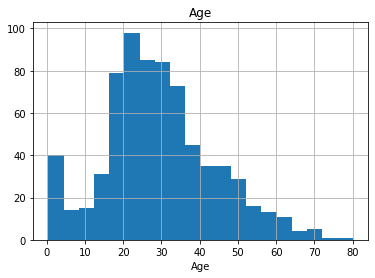

count   714.000
mean      0.000
std       1.001
min      -2.017
5%       -1.770
10%      -1.081
20%      -0.737
30%      -0.530
40%      -0.324
50%      -0.117
60%       0.145
70%       0.434
80%       0.778
90%       1.398
95%       1.812
99%       2.492
max       3.465
Name: Age_standard_scaler, dtype: float64


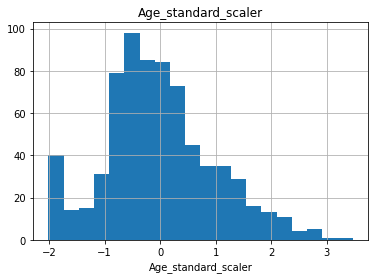

count   714.000
mean      0.095
std       0.813
min      -1.543
5%       -1.343
10%      -0.783
20%      -0.503
30%      -0.336
40%      -0.168
50%       0.000
60%       0.213
70%       0.448
80%       0.727
90%       1.231
95%       1.566
99%       2.119
max       2.909
Name: Age_robust_scaler, dtype: float64


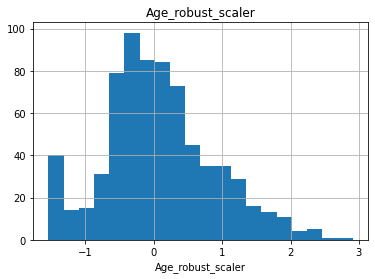

count   714.000
mean      0.368
std       0.183
min       0.000
5%        0.045
10%       0.171
20%       0.233
30%       0.271
40%       0.309
50%       0.347
60%       0.394
70%       0.447
80%       0.510
90%       0.623
95%       0.698
99%       0.822
max       1.000
Name: Age_min_max_scaler, dtype: float64


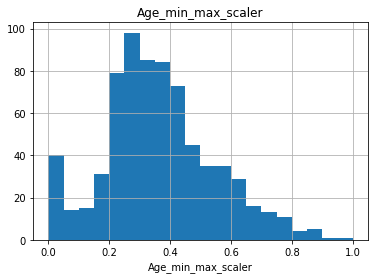

In [221]:
for col in age_cols:
    num_summary(df,col,plot=True)

plt.show(block=True)

sonuç : yapılarını koruyacak şekilde ifade tarzlarını değiştirdik dağılım bozulmadı

Numeric to Categorical : Sayısal Değişkenleri Kategorik Değişkenlere Çevirme
* Binning

* yaş/qcut
* kaç parça olacak = 5
* label olsa girecektik
* k den b ye sıralar ve çeyrek değerlere böler


qcut = > ilgili değişkeni min den max noktasına kadar sıralıyor ve bizim verdiğimiz sayıya bölüyor 

In [222]:
df["Age_qcut"] = pd.qcut(df['Age'],5)

df.head()


,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,Age_standard_scaler,Age_robust_scaler,Age_min_max_scaler,Age_qcut
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S,-0.530,-0.336,0.271,"(19.0, 25.0]"
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C,0.572,0.559,0.472,"(31.8, 41.0]"
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S,-0.255,-0.112,0.321,"(25.0, 31.8]"
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S,0.365,0.392,0.435,"(31.8, 41.0]"
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S,0.365,0.392,0.435,"(31.8, 41.0]"


# Features Interactions (Özellik Etkileşimleri) 

* Ne demek ?

* değişkenlerin birbirleriyle ilişkide olması demek
* bir değişkenin çarpılması,toplanması,karesinin alınması,küpü........ vs

* örn
* yaş değişkeni ile pclassları çarpalım
* yaş değişkenin pclass ile arasındaki ilişkiye bakalım/refah durumu


### Binary Features : Flag, Bool, True - False

In [224]:
def load():
    data = pd.read_csv('/titanic.csv')
    return  data

In [225]:
df = load()

* NA = 0 -> boş değerler
* Diğerleri/Dolu = 1 yazalım bir gözlemleyelim

In [226]:
df["NEW_CABIN_BOOL"] = df["Cabin"].notnull().astype('int')

In [227]:
df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,NEW_CABIN_BOOL
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S,0
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C,1
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S,0
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S,1
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S,0


bağımlı değişkene göre ortalamayı alalım

In [228]:
df.groupby("NEW_CABIN_BOOL").agg({"Survived":"mean"})

,Survived
NEW_CABIN_BOOL,
0,0.300
1,0.667


sonuç: kabini dolu olanların hayatta kalma oranları : "1" ve daha yüksektir

* bu gerçekten bir ilişki taşıyor mu ?
* oran testi yaparak sağlamasını yapalım

In [229]:
from statsmodels.stats.proportion import proportions_ztest

test_stat,pvalue = proportions_ztest(count=[df.loc[df["NEW_CABIN_BOOL"] == 1, "Survived"].sum(),
                                            df.loc[df["NEW_CABIN_BOOL"]  == 0, "Survived"].sum()],

                                    nobs=[df.loc[df["NEW_CABIN_BOOL"] == 1, "Survived"].shape[0],
                                        df.loc[df["NEW_CABIN_BOOL"] == 0, "Survived"].shape[0]])

print('Test Stat = % 4f, p-value = %4f' % (test_stat,pvalue))

Test Stat =  9.459690, p-value = 0.000000


/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


p - value değeri 0.05 den küçük olduğundan değeri ikisi arasında farklılıklar vardır .

* gemideki akrabalıkları ifade eder yani bu kişi gemide yalnız değilmiş
* eğer yalnızsa -> yes , değilse -> no
* hayatta kalma çabasını etkileyebilir yalnız olmaması

In [230]:
df.loc[(df['SibSp'] + df['Parch'] + df['Parch'] > 0) , "NEW_IS_ALONE"] = "NO"
df.loc[(df['SibSp'] + df['Parch'] + df['Parch'] == 0), "NEW_IS_ALONE"] = "YES"

sonuç : yalnız olanların hayatta kalma oranları daha düşük

In [231]:
df.groupby("NEW_IS_ALONE").agg({"Survived":"mean"})

,Survived
NEW_IS_ALONE,
NO,0.506
YES,0.304


hipotez testi yapalım

In [232]:
test_stat,pvalue = proportions_ztest(count=[df.loc[df["NEW_IS_ALONE"] == "YES", "Survived"].sum(),
                                            df.loc[df["NEW_IS_ALONE"]  == "NO", "Survived"].sum()],

                                    nobs=[df.loc[df["NEW_IS_ALONE"] == "YES", "Survived"].shape[0],
                                        df.loc[df["NEW_IS_ALONE"] == "NO", "Survived"].shape[0]])

print('Test Stat = % 4f, p-value = %4f' % (test_stat,pvalue))

Test Stat = -6.070431, p-value = 0.000000


sonuç : hayatta kalma durumunu kesin olarak göstermez ama göz ardı edilemeyeceğini gösterir,daha net etkisi modellemede farkedilir

# Text'ler Üzerinden Özellik Türetmek

In [233]:
df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,NEW_CABIN_BOOL,NEW_IS_ALONE
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S,0,NO
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C,1,NO
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S,0,YES
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S,1,NO
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S,0,YES


mesala bir veri setindeki metinlerden değişkenler türetelim

#### Letter Count

namedeki ifadeleri say

In [234]:
df["NEW_NAME_COUNT"] = df["Name"].str.len()

bir değişkende kaç tane harf var saydırır

In [235]:
df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,NEW_CABIN_BOOL,NEW_IS_ALONE,NEW_NAME_COUNT
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S,0,NO,23
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C,1,NO,51
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S,0,YES,22
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S,1,NO,44
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S,0,YES,24


# Word Count

* ismi yakalayım stringe çevirsin
* sonra split et ve kaç tane varsa sa

In [236]:
df["NEW_NAME_WORD_COUNT"] = df["Name"].apply(lambda x: len(str(x).split(" ")))

df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,NEW_CABIN_BOOL,NEW_IS_ALONE,NEW_NAME_COUNT,NEW_NAME_WORD_COUNT
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S,0,NO,23,4
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C,1,NO,51,7
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S,0,YES,22,3
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S,1,NO,44,7
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S,0,YES,24,4


# Özel Yapıları Yakalama

dipnot: mümkün olduğunca az değişkenle yüksek başarı elde etmek istiyoruz 
* dr ifadesini seç

In [237]:
df["NEW_NAME_DR"] = df["Name"].apply(lambda  x: len([x for x in x.split() if x.startswith("Dr")]))

df

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,NEW_CABIN_BOOL,NEW_IS_ALONE,NEW_NAME_COUNT,NEW_NAME_WORD_COUNT,NEW_NAME_DR
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S,0,NO,23,4,0
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C,1,NO,51,7,0
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S,0,YES,22,3,0
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S,1,NO,44,7,0
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S,0,YES,24,4,0
5,6,0,3,"Moran, Mr. James",male,NaN,0,0,330877,8.458,NaN,Q,0,YES,16,3,0
6,7,0,1,"McCarthy, Mr. Timothy J",male,54.000,0,0,17463,51.862,E46,S,1,YES,23,4,0
7,8,0,3,"Palsson, Master. Gosta Leonard",male,2.000,3,1,349909,21.075,NaN,S,0,NO,30,4,0
8,9,1,3,"Johnson, Mrs. Oscar W (Elisabeth Vilhelmina Berg)",female,27.000,0,2,347742,11.133,NaN,S,0,NO,49,7,0
9,10,1,2,"Nasser, Mrs. Nicholas (Adele Achem)",female,14.000,1,0,237736,30.071,NaN,C,0,NO,35,5,0


* df.head veya df dediğimizde gözlemleyemeyiz o yüzden dr ye göre groupby yapacağız
* survived a göre mean al
* sonuç : dr olanların hayatta kalma oranları daha yüksektir

In [238]:
df.groupby("NEW_NAME_DR").agg({"Survived" : "mean"})

,Survived
NEW_NAME_DR,
0,0.383
1,0.500


kaç dr var

In [239]:
df.groupby("NEW_NAME_DR").agg({"Survived":["mean","count"]}) 

Survived      
                mean count
NEW_NAME_DR               
0              0.383   881
1              0.500    10

# Regex Features ile Değişken Türetmek

In [240]:
df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,NEW_CABIN_BOOL,NEW_IS_ALONE,NEW_NAME_COUNT,NEW_NAME_WORD_COUNT,NEW_NAME_DR
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S,0,NO,23,4,0
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C,1,NO,51,7,0
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S,0,YES,22,3,0
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S,1,NO,44,7,0
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S,0,YES,24,4,0


* pattern / örüntüyü anlamamız lazım
* metinler arasındaki
* MR MS gibi hepsinde aynı gibi
* büyük ya da küçük harflerden oluşacak diye ayarlayacam

In [241]:
df['NEW_TITLE']  = df.Name.str.extract(' ([A-Za-z]+)\.', expand = False)

df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,NEW_CABIN_BOOL,NEW_IS_ALONE,NEW_NAME_COUNT,NEW_NAME_WORD_COUNT,NEW_NAME_DR,NEW_TITLE
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S,0,NO,23,4,0,Mr
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C,1,NO,51,7,0,Mrs
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S,0,YES,22,3,0,Miss
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S,1,NO,44,7,0,Mrs
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S,0,YES,24,4,0,Mr


groupby yapacağız

In [242]:
df[["NEW_TITLE", "Survived","Age",]].groupby(["NEW_TITLE"]).agg({"Survived":"mean", "Age": ["count","mean"]})
df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,NEW_CABIN_BOOL,NEW_IS_ALONE,NEW_NAME_COUNT,NEW_NAME_WORD_COUNT,NEW_NAME_DR,NEW_TITLE
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S,0,NO,23,4,0,Mr
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C,1,NO,51,7,0,Mrs
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S,0,YES,22,3,0,Miss
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S,1,NO,44,7,0,Mrs
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S,0,YES,24,4,0,Mr


sonuç : yaş ortalamasını sınıf bazında göreceğiz
* veri değişken üzerinden yeni değişken türettim , bu kategorik değişken üzerinden yeni değişken türetmek daha mantıklı

# Features Interactions (Özellik Etkileşimleri) 

Ne demek ?

* değişkenlerin birbirleriyle ilişkide olması demek
* bir değişkenin çarpılması,toplanması,karesinin alınması,küpü........ vs

* örn
* yaş değişkeni ile pclassları çarpalım
* yaş değişkenin pclass ile arasındaki ilişkiye bakalım/refah durumu

In [243]:
df["NEW_AGE_PCLASS"] = df["Age"] * df["Pclass"]

df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,NEW_CABIN_BOOL,NEW_IS_ALONE,NEW_NAME_COUNT,NEW_NAME_WORD_COUNT,NEW_NAME_DR,NEW_TITLE,NEW_AGE_PCLASS
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S,0,NO,23,4,0,Mr,66.000
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C,1,NO,51,7,0,Mrs,38.000
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S,0,YES,22,3,0,Miss,78.000
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S,1,NO,44,7,0,Mrs,35.000
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S,0,YES,24,4,0,Mr,105.000


 mesala akraba sayıları ve ilişkileri +1 kendisi dersek

In [244]:
df["NEW_FAMILY_SIZE"] = df["SibSp"] + df["Parch"] + 1
df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,NEW_CABIN_BOOL,NEW_IS_ALONE,NEW_NAME_COUNT,NEW_NAME_WORD_COUNT,NEW_NAME_DR,NEW_TITLE,NEW_AGE_PCLASS,NEW_FAMILY_SIZE
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S,0,NO,23,4,0,Mr,66.000,2
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C,1,NO,51,7,0,Mrs,38.000,2
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S,0,YES,22,3,0,Miss,78.000,1
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S,1,NO,44,7,0,Mrs,35.000,2
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S,0,YES,24,4,0,Mr,105.000,1


belirli kategorik ve sayısal değişkenlerin etkileşimleri

yaşı 21 den küçük olan erkekler

In [245]:
df.loc[(df["Sex"] == 'male') & (df['Age'] < 21), 'NEW_SEX_CAT'] = 'youngmale'

yaşı 21 den büyük olan erkekler

In [246]:
df.loc[(df["Sex"] == 'male') & (df['Age'] > 21), 'NEW_SEX_CAT'] = 'maturemale'

yaşı 50 den büyük olan erkekler

In [247]:
df.loc[(df["Sex"] == 'male') & (df['Age'] < 21), 'NEW_SEX_CAT'] = 'seniormale'

aynı işlemleri kadınlar için de yapıyoruz

yaşı 21 den küçük olan kadınlar

In [248]:
df.loc[(df["Sex"] == 'female') & (df['Age'] < 21), 'NEW_SEX_CAT'] = 'youngfemale'

yaşı 21 den büyük olan kadınlar

In [249]:
df.loc[(df["Sex"] == 'female') & (df['Age'] > 21), 'NEW_SEX_CAT'] = 'maturefemale'

yaşı 50 den büyük olan kadınlar

In [250]:
df.loc[(df["Sex"] == 'female') & (df['Age'] < 21), 'NEW_SEX_CAT'] = 'seniorfemale'

In [251]:
df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,NEW_CABIN_BOOL,NEW_IS_ALONE,NEW_NAME_COUNT,NEW_NAME_WORD_COUNT,NEW_NAME_DR,NEW_TITLE,NEW_AGE_PCLASS,NEW_FAMILY_SIZE,NEW_SEX_CAT
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000,1,0,A/5 21171,7.250,NaN,S,0,NO,23,4,0,Mr,66.000,2,maturemale
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000,1,0,PC 17599,71.283,C85,C,1,NO,51,7,0,Mrs,38.000,2,maturefemale
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000,0,0,STON/O2. 3101282,7.925,NaN,S,0,YES,22,3,0,Miss,78.000,1,maturefemale
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000,1,0,113803,53.100,C123,S,1,NO,44,7,0,Mrs,35.000,2,maturefemale
4,5,0,3,"Allen, Mr. William Henry",male,35.000,0,0,373450,8.050,NaN,S,0,YES,24,4,0,Mr,105.000,1,maturemale


* analiz/ çıkarım aşaması
* yaş ve cinsiyet bazında hayatta kalanların yaş aralık ortalaması

In [252]:
df.groupby("NEW_SEX_CAT")["Survived"].mean()

NEW_SEX_CAT
maturefemale   0.791
maturemale     0.189
seniorfemale   0.688
seniormale     0.282
Name: Survived, dtype: float64